# Are Detector Effects Inducing Ambiguous $\omega\pi^0$ PWA Results?
The results of the [detector effects](../detector_effects/detector_effects.ipynb) input-output study showed no clear indication of where the bin-to-bin inconsistencies are occurring in $\omega\pi^0$ partial wave analysis. No single detector effect appeared to be responsible for the problem, but it was clear that when using the *ideal* or "thrown" Monte Carlo data, there were no issues (aside from the expected fluctuations in negative reflectivity $\varepsilon=-1$ waves). This suggests that the detector effects could be "muddying" the likelihood to such a degree that an unambiguous minimum is no longer obtainable. The best way to check for ambiguities is to project the partial wave results to **Moments**. 

In short, moments $H$ are the expansion coefficients of orthogonal basis functions 
$$
    I^\alpha(\Omega,\Omega_H) = 
        \sum_{J_v=0}^2
        \sum_{\Lambda=-2}^{2}
        \sum_{J=0}^{2*\text{max}(J_i)}
        \sum_{M=-2*\text{max}(m_i)}^{2*\text{max}(m_i)}
        \frac{2J+1}{4\pi} \frac{2J_v+1}{4\pi}
        H^\alpha(J_v,\Lambda,J,M) 
        D_{M,\Lambda}^{J\ast}(\Omega) D_{\Lambda,0}^{J_v\ast}(\Omega_H)
        \,,
$$
here the Wigner D-functions $D_{m,n}^i(\theta,\phi,0)$, that describe our intensity. Though they lack the physical interpretation that partial waves provide, they are unique by construction i.e. do not suffer from ambiguous solutions. Moments can be written in terms of spin density matrix elements $\rho_{i,j,m_i,m_j}$ as
\begin{align*}
H^\alpha(J_v,\Lambda,J,M) = 
        &\sum_{i=0}^{\text{max}(J\ell)_i}
        \sum_{j=0}^{\text{max}(J\ell)_j}
        \sum_{m_i=-J_i}^{J_i}
        \sum_{m_j=-J_j}^{J_j}
        \sum_{\lambda=-1}^1
        \sum_{\lambda'=-1}^1
        \frac{1}{2J_j+1} \frac{1}{3}
        \\
        &\times
        \braket{\ell_i,0;1,\lambda|J_i,\lambda}
        \braket{\ell_j,0;1,\lambda'|J_j,\lambda'}
        \\
        &\times
        \braket{1,\lambda;J_v,\Lambda|1,\lambda'}
        \braket{1,0;J_v,0|1,0}        
        \\
        &\times 
        \braket{J_i,m_i;J,M|J_j,m_j}
        \braket{J_i,\lambda;J,\Lambda|J_j,\lambda'}
        \rho_{i,j,m_i,m_j}^\alpha        
    \,,
\end{align*}
which are composed of the PWA complex production coefficients $[c]$ in the reflectivity basis
\begin{align}    
    \rho^0_{i,j,m_i,m_j} &=
    \sum_\varepsilon
        [c^i]_{m_i}^{\varepsilon} [c^j]_{m_j}^{\varepsilon\ast} +
        (-1)^{m_i+m_j+\ell_i+\ell_j+J_i+J_j}
        [c^i]_{-m_i}^{\varepsilon} [c^j]_{-m_j}^{\varepsilon\ast}
    \,,
    \\          
    \rho^1_{i,j,m_i,m_j} &=
    \sum_\varepsilon
        \varepsilon \left(
            (-1)^{1+m_i+\ell_i+J_i}
            [c^i]_{-m_i}^{\varepsilon} [c^j]_{m_j}^{\varepsilon\ast} +
            (-1)^{1+m_j+\ell_j+J_j}
            [c^i]_{m_i}^{\varepsilon} [c^j]_{-m_j}^{\varepsilon\ast}
        \right)
    \,,    
    \\  
    \rho^2_{i,j,m_i,m_j} &= i
    \sum_\varepsilon
        \varepsilon \left(
            (-1)^{m_i+\ell_i+J_i}
            [c^i]_{-m_i}^{\varepsilon} [c^j]_{m_j}^{\varepsilon\ast} -
            (-1)^{m_j+\ell_j+J_j}
            [c^i]_{m_i}^{\varepsilon} [c^j]_{-m_j}^{\varepsilon\ast}
        \right)  
    \,.    
\end{align}
For a more detailed explanation of these moments and how they can be obtained from the original partial wave description of the intensity, see [the linked note](https://halldweb.jlab.org/doc-private/DocDB/ShowDocument?docid=6715). When ambiguities are present this effectively means different combinations of partial wave values can reproduce the same intensity value, and thus the same moments. The core problem is one of an underdetermined system of equations, in which there are simply more free parameters (partial waves) than equations to constrain them. By projecting out the moments for two partial wave fit results, we can determine whether or not they are part of the same unique solution, and thus ambiguous.

This study will have a very similar structure to the detector effects study, where a "truth" file for each detector effect that contains the true generated values is used as a comparison point for "truth-initialized" fits, or a fit whose parameters are initialized to the generated values. This study will project out the moment values from the truth and truth-initialized results in each detector effect situation. If the fit result agrees with the truth values, such as in the *ideal* case, then there is no concern, as its clear the fit is able to arrive at the true solution. If the partial wave fits do not agree, then we can expect the following two outcomes:

1. **The projected moment values agree** and thus each fit is one of potentially many ambiguous solutions. As stated before, differing partial wave results with identical moments means that we have found a case in which the same intensity value can be described by different sets of partial wave values.
2. **The projected moment values disagree** and so we can conclude that our fit is diverging towards a uniquely different solution from the true one. 

Both situations are troubling. The only way to solve the ambiguities of case 1 would be to add constraints e.g. mass-dependent functions and/or removing waves. Case 2 does not rule out whether the true minima has ambiguities, and tells us that for some odd reason the fit diverges to a wrong result, despite being initialized right at the true set of parameters.

## Study Details
At its core, this is an input-output study. The input is [GlueX $\omega\pi^0$ Monte Carlo](https://halldweb.jlab.org/wiki-private/index.php/Omega_Pi_Simulation_Samples_Version_3#Neutral_signal_versionsver3.1) signal (`ver3.1`) and phasespace (`ver03`) files, that are passed through a DSelector which turns on/off several detector effects. The output is the partial wave fits, whose values are initialized to the "true" values that generated the input, and the corresponding moments projected from those fits.

### Input
We have the following effects available to study:
1. **No effects (referred to as *thrown* or *ideal*):** This is the "perfect detector" scenario where all tracks are detected, reconstructed, and identified exactly
2. **Acceptance Effects:** In this case the detector acceptance is applied, and so we only use tracks that are detected in the simulation. Note that the 4-momenta still match their generated values
3. **Reconstruction (or *matched*):** Now we apply the reconstruction algorithm, and so our 4 momenta now have some resolution effects applied to them. This is called the *matched* case because we are still using perfect identification of the particles i.e. we know precisely which two photons were produced from the $\pi^0$ in the $\omega\rightarrow \pi^+\pi^-\pi^0$ decay, which otherwise could have been confused with the $\pi^0$ in the $X\rightarrow \omega\pi^0$ decay. We do this by "matching" the generated to the reconstructed tracks for the photons. In this way we use the reconstructed values but have no mis-identification possibilities
   1. Note that we are only matching the $\pi^0$'s, but in theory the $\pi^+$ from the $\omega$ could be confused with the recoil proton. This is highly unlikely to occur though, and so is of no concern.
4. **All Effects:** This final step applies the detector effects, reconstruction algorithm, and allows for $\pi^0$ combinatorics to occur, thus providing the closest approximation of real data as possible.

In addition to the above, every one of these steps has an additional effect we can tack on: the out-of-time beam photons. When we use any "no-accidental" data, it means that our beam photon 4-momenta comes from the exact photon that generated the event. This is an idealized case, and we can instead simulate real data by having a set of out-of-time photons lie under the prompt in-time peak. To best determine what photon generated the event, we will then have to use the RF sideband subtraction method to remove these out-of-time photons, which is of course not perfect and can cause us to use the wrong photon. In short, any dataset labelled "noaccidental" uses the precise beam photon that generated the event, and datasets without this flag use RF sideband subtraction.

All together we have 8 datasets: 4 simulated effects + with/without RF sideband subtraction for each.

For any of these detector scenarios, the data is separated into bins of $\omega\pi^0$ mass 20 MeV wide, from 1.0 - 2.0 GeV. It uses the coherent peak energy range (8.2 - 8.8 GeV) and selects events within the the four moment transfer window $0.3 < -t < 0.5~GeV^2$. There is nothing particularly special about this window, but was simply chosen to limit the dataset file sizes. 

#### Getting the truth information
We'd like to compare how well our output aligns with our true generated values, but obtaining those true values is not so simple. As discussed, this input comes from a mass-dependent fit, causing 2 problems
1. The overall scale of the production parameters are sensitive to the total intensity i.e. the number of events, but the input data is generated with a different number of events than the we originally fit to, and these events are further modified by detector effects
2. The production parameters are constant for the entire mass range, and are modulated continuously by the Breit-Wigners. We want the values for individual mass bins.
   
We can alleviate both of these issues by performing a highly constrained fit in each mass bin using a `truth.cfg` file. This file fixes all the production coefficients to their generated values, but multiplies them all by an `intensity_scale` factor, which is left floating in the fit. This forces the fitter to keep the same interference behavior and allow the fit to adjust to any overall intensity, thus addressing Problem 1. The data is partitioned already into bins of 20 MeV, and so by running these fits with this config, the included Breit-Wigner functions will properly adjust the production coefficients for this narrow mass bin, handling Problem 2. This provides us with a set of properly scaled production coefficients, and therefore amplitudes, to compare with in each mass bin for any detector scenario. The moments can also be projected from these production coefficients, giving us a set of "truth moments" that we can compare our output "fit moments" to.

### Output
The output we want to analyze will be the results of our truth-initialized fits. The truth-initialized fits are nearly identical to the `truth.cfg` file, but here we are letting the production parameters (which are initialized to the true values) float and fixing the `intensity_scale` parameter to the value obtained by the truth fit for that bin. In other words, we are starting the fit off at the true set of production coefficients, and we use the result of the truth fit to properly scale those coefficients for the number of events in that bin. By all expectations, we should be starting the fit off at the likelihood minimum and don't expect these truth-initialized fits to diverge from where they start. We can of course project out the moment values of these truth-initialized fits and compare them with our true moment values. As discussed in the introduction, if the amplitude outputs are different than the inputs, then the moments can be used to check for the presence of underconstrained ambiguities.

#### Bootstrapping for uncertainties
When comparing amplitude values, we often bootstrap the data to get a better approximation of the statistical errors compared to the MINUIT estimated error. This procedure is important for amplitudes, but necessary for moments, as propagating the MINUIT uncertainties from the production coefficients all the way to the moments is complicated. We can avoid this difficult propagation by instead projecting out the moments from the bootstrapped fits, thus providing an approximation on the error for the moments.

## Loading Data and Pre-Processing

### Packages
Lets start by loading in some packages and paths

In [2]:
# load some typical libraries
import pandas as pd
import numpy as np
import math
import re
import scipy
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns
from typing import Dict, List

# load in default matplotlib style
plt.style.use("/w/halld-scshelf2101/kscheuer/neutralb1/analysis/scripts/pwa_plotter.mplstyle")

# load useful paths and functions
from pathlib import Path
import os, sys
PARENT_DIR = str(Path().resolve().parents[2])
WORKING_DIR = f"{PARENT_DIR}/analysis/input-output-tests/moment-projection/"
sys.path.insert(0, PARENT_DIR)
import analysis.scripts.pwa_tools as pwa_tools

# Load the environment variables. This contains needed setup_gluex.sh variables e.g. $ROOTSYS, $HALLD_HOME
import subprocess
command = f"bash -l -c 'source {PARENT_DIR}/setup_gluex.sh && env'"
proc = subprocess.Popen(command, stdout=subprocess.PIPE, shell=True, executable='/bin/bash')
output, _ = proc.communicate()
# Parse the environment variables
env_vars = {}
for line in output.decode().splitlines():       
    # the output contains a bunch of BASH_FUNCS that will ruin the environment variables. this avoids those issues
    if len(line.split('=', 1)) != 2 or line.startswith("BASH_FUNC") or line.startswith(" ") or line.startswith("\t"):
        continue    
    key, value = line.split('=', 1)
    env_vars[key] = value
os.environ.update(env_vars)

We'll also setup a few other useful constants as well

In [3]:
scenario_list = ["thrown", "accept_noacc", "accept", "matched_noacc", "matched", "all_noacc", "all_effects"]
# when showing scenarios on same plots, we'll want a consistent color and marker scheme
SCENARIO_COLORS = dict(zip(scenario_list, sns.color_palette("deep", len(scenario_list))))
SCENARIO_MARKERS = dict(zip(scenario_list, ["o", "s", "D", "P", "X", "v", "^"]))

### Loading fit results
The following cell is in raw mode to avoid unnecessary execution, and is kept here as a reminder of what flags were used to submit the fits

Lets now convert all the results into the needed csv files

In [4]:
import glob
import tempfile
def collect_csv_files(parent_path:str, scenario:str) -> None:
    """Aggregate all the different csv files for a given scenario

    Makes a csv for the the truth, fit, and data files, and the moments of the truth and fit files.
    Also make fit and moment csv files for the bootstrap fits.
    parent_path must end at the truth subdirectory
    """

    # make sure the parent path is valid
    parent_path += "/" if not parent_path.endswith("/") else ""
    parent_path = os.path.expanduser(parent_path) # expand the ~
    if not parent_path.endswith("truth/"):
        raise ValueError("parent_path must end at the truth subdirectory")
    
    # path to the conversion script and common output directory
    script = f"{PARENT_DIR}/analysis/scripts/collect_csv.py"
    output_dir = f"{WORKING_DIR}{scenario}"
    if not os.path.exists(output_dir):
        raise FileNotFoundError(f"Directory {output_dir} does not exist")

    # input path for each file
    input_files = [
        "best.csv", # truth
        "init/best.csv", # fits
        "data.csv", # data
        "best_moments_table.csv", # production coefficient table
        "best_moments.csv", # truth moments
        "init/best_moments.csv", # fit moments        
        "init/bootstrap/bootstrap.csv", # bootstrap fits
        "init/bootstrap/bootstrap_moments.csv", # bootstrap moments        
    ]

    output_names = [ # in same order as input_files
        "truth.csv",
        "fit.csv",
        "data.csv",
        "table.csv",
        "truth_moments.csv",        
        "fit_moments.csv",        
        "bootstrap.csv",
        "bootstrap_moments.csv",
    ]
    # create csvs if they don't exist
    for f, name in zip(input_files, output_names):        
        if not os.path.exists(f"{output_dir}/{name}"):    
            full_input = glob.glob(f"{parent_path}{f}") # expand the wildcards
            # use a tempfile to store all the files to not overload the subprocess command
            with tempfile.NamedTemporaryFile(delete=False, mode='w') as temp_file:
                temp_file.write("\n".join(full_input))
                temp_file_path = temp_file.name                       
            
            subprocess.run(["python", script, "-i", temp_file_path, "-o", f"{output_dir}/{name}"])            
        else:
            print(f"{output_dir}/{name} already exists, skipping")

    return

common_path = (
    "~/volatile/ampToolsFits/omegapi/allPeriods/PARA_0/ver03.1_mcSCENARIO/"
    "ver03OPTION/1m_1p_iso/recoil-pi-mass_0.0/t_0.30-0.50/*/truth/"
)
collect_csv_files(common_path.replace("SCENARIO", "thrown").replace("OPTION", ""), "thrown")
collect_csv_files(common_path.replace("SCENARIO", "accept_noaccidental").replace("OPTION", "_accept"), "accept_noaccidental")
collect_csv_files(common_path.replace("SCENARIO", "accept").replace("OPTION", "_accept"), "accept")
collect_csv_files(common_path.replace("SCENARIO", "matched_noaccidental").replace("OPTION", "_matched"), "matched_noaccidental")
collect_csv_files(common_path.replace("SCENARIO", "matched").replace("OPTION", "_matched"), "matched")
# collect_csv_files(common_path.replace("SCENARIO", "noaccidental").replace("OPTION", ""), "all_noaccidental")
collect_csv_files(common_path.replace("SCENARIO", "").replace("OPTION", ""), "all_effects")

/w/halld-scshelf2101/kscheuer/neutralb1/analysis/input-output-tests/moment-projection/thrown/truth.csv already exists, skipping
/w/halld-scshelf2101/kscheuer/neutralb1/analysis/input-output-tests/moment-projection/thrown/fit.csv already exists, skipping
/w/halld-scshelf2101/kscheuer/neutralb1/analysis/input-output-tests/moment-projection/thrown/data.csv already exists, skipping
/w/halld-scshelf2101/kscheuer/neutralb1/analysis/input-output-tests/moment-projection/thrown/table.csv already exists, skipping
/w/halld-scshelf2101/kscheuer/neutralb1/analysis/input-output-tests/moment-projection/thrown/truth_moments.csv already exists, skipping
/w/halld-scshelf2101/kscheuer/neutralb1/analysis/input-output-tests/moment-projection/thrown/fit_moments.csv already exists, skipping
/w/halld-scshelf2101/kscheuer/neutralb1/analysis/input-output-tests/moment-projection/thrown/bootstrap.csv already exists, skipping
/w/halld-scshelf2101/kscheuer/neutralb1/analysis/input-output-tests/moment-projection/thr

and then load all of these into pandas dataframes. Pandas will interpret the moment csv's to be strings, so we need to ensure they're interpreted as complex values.

In [5]:
def load_dataframes(subdir:str) -> Dict[str, pd.DataFrame]:
    if not subdir.endswith("/"):
        subdir += "/"

    # load dataframes. Assumes files all in same format for any subdir
    truth = pd.read_csv(f"{subdir}truth.csv")
    truth_moments = pd.read_csv(f"{subdir}truth_moments.csv")
    fit = pd.read_csv(f"{subdir}fit.csv")
    fit_moments = pd.read_csv(f"{subdir}fit_moments.csv")
    bootstrap = pd.read_csv(f"{subdir}bootstrap.csv")
    bootstrap_moments = pd.read_csv(f"{subdir}bootstrap_moments.csv")
    data = pd.read_csv(f"{subdir}data.csv")
    table = pd.read_csv(f"{subdir}table.csv")

    # make sure moment dataframes register as complex values (except for the file column)
    truth_moments.loc[:, truth_moments.columns != "file"] = truth_moments.loc[:, truth_moments.columns != "file"].astype(complex)
    fit_moments.loc[:, fit_moments.columns != "file"] = fit_moments.loc[:, fit_moments.columns != "file"].astype(complex)
    bootstrap_moments.loc[:, bootstrap_moments.columns != "file"] = bootstrap_moments.loc[:, bootstrap_moments.columns != "file"].astype(complex)    

    df_dict = {
        "truth" : truth,
        "truth_moments" : truth_moments,
        "fit" : fit,
        "fit_moments" : fit_moments,
        "bootstrap" : bootstrap,
        "bootstrap_moments" : bootstrap_moments,
        "data" : data,
        "table": table
    }

    return df_dict

# Load all the dataframes
thrown_dfs = load_dataframes(f"{WORKING_DIR}thrown/")
accept_noacc_dfs = load_dataframes(f"{WORKING_DIR}accept_noaccidental/")
accept_dfs = load_dataframes(f"{WORKING_DIR}accept/")
matched_noacc_dfs = load_dataframes(f"{WORKING_DIR}matched_noaccidental/")
matched_dfs = load_dataframes(f"{WORKING_DIR}matched/")
# all_noacc_dfs = load_dataframes(f"{WORKING_DIR}all_noaccidental/")
all_effect_dfs = load_dataframes(f"{WORKING_DIR}all_effects/")

all_dfs = {
    "thrown": thrown_dfs,
    "accept_noacc": accept_noacc_dfs,
    "accept": accept_dfs,
    "matched_noacc": matched_noacc_dfs,
    "matched": matched_dfs,
    # "all_noacc": all_noacc_dfs,
    "all_effects": all_effect_dfs
}

The dataframes are indexed by the file name, which shares a common mass bin with other dataframes like "path/mass_X.x-Y.y/subdir/". We'll add a new "mass" column to the dataframes which explicitly extracts this mass bin range, which will make comparisons across dataframes easier later.

In [6]:
def extract_mass(file_name):
    match = re.search(r"/mass_([\d.]+-[\d.]+)", file_name)
    if match:
        return match.group(1)
    else:
        raise ValueError("Mass not found in file name.")
    
for scenario, df_dict in all_dfs.items():
    for name, df in df_dict.items():
        if name == "table":
            continue
        if "mass" not in df.columns:
            df["mass"] = df["file"].apply(extract_mass)

### Pre-Processing
Before we get into any real analysis, we'll want to run some common checks on our moments to ensure that they're projection from amplitudes $\rightarrow$ moments ran as expected. We'll also apply some filters and transforms to prepare the values for plots later.

#### Real & Imaginary Parts
First let's check that the imaginary (real) parts of the $H^0,H^1~(H^2)$ moments are zero as we expect. Lets plot these components as a function of mass for each file's truth and fit moments. We'll plot them all together, even though the plot can get crowded, just to check that they all within some floating point error tolerance of zero. We can also use this chance to check that our truth and fit results have the same moment set as well i.e. number of rows and columns in the csv's match

Plotting thrown


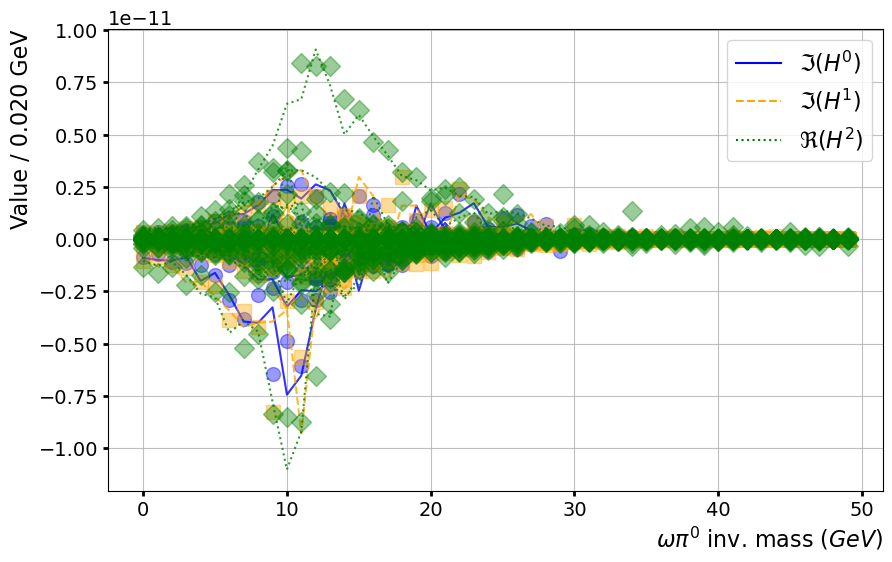

Plotting accept_noacc


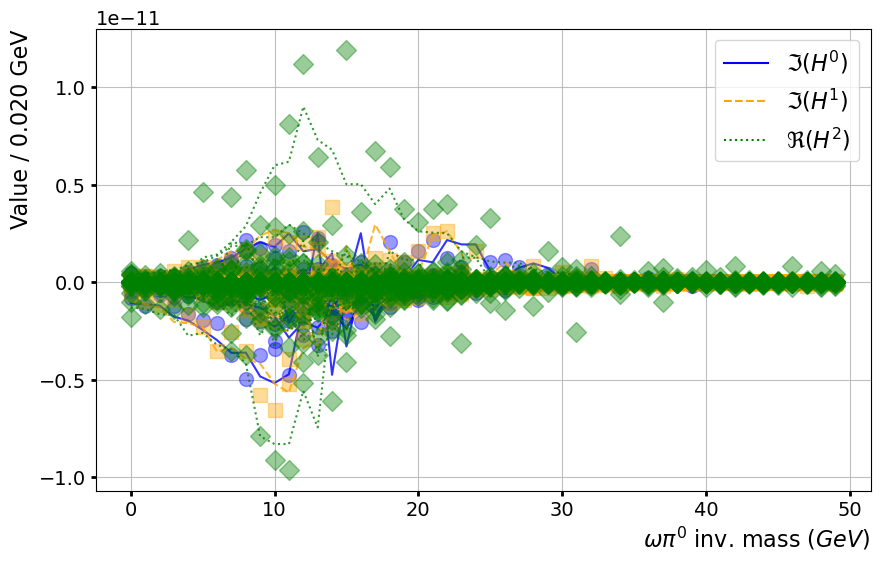

Plotting accept


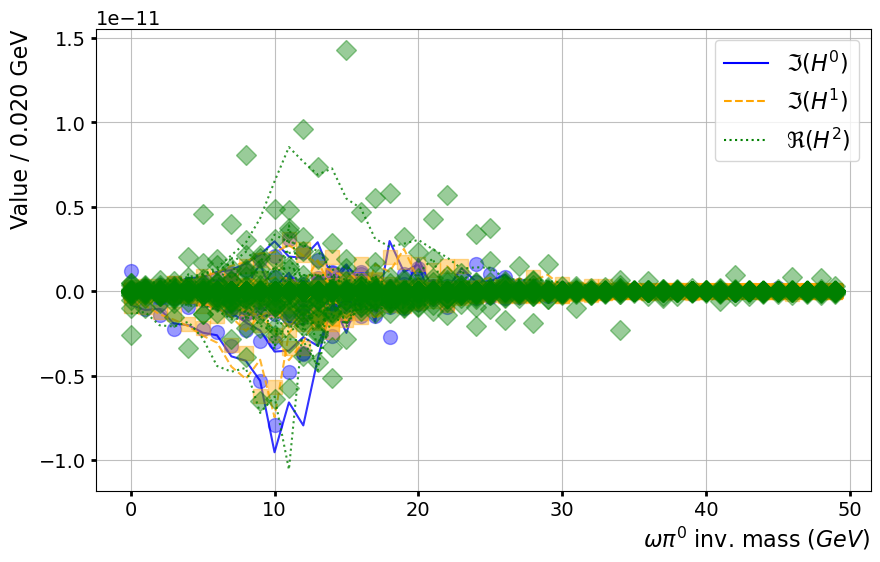

Plotting matched_noacc


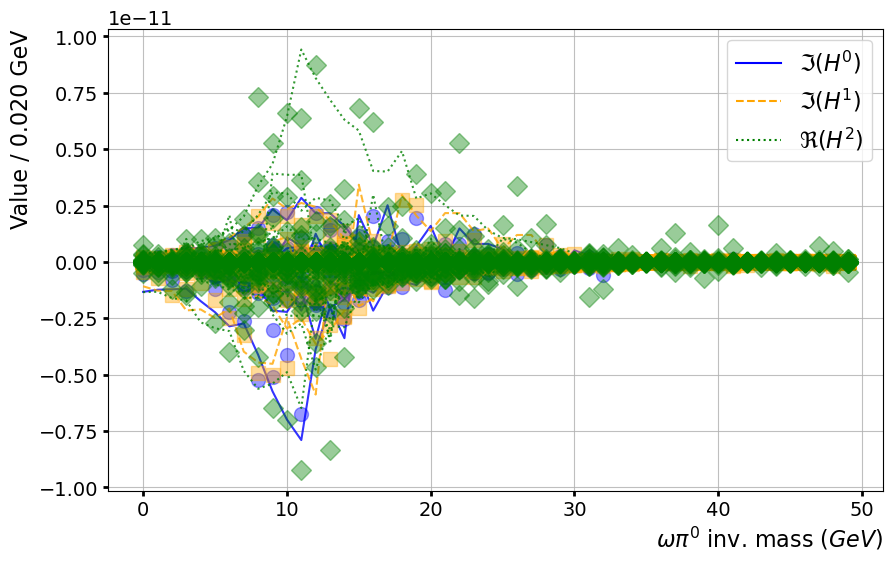

Plotting matched


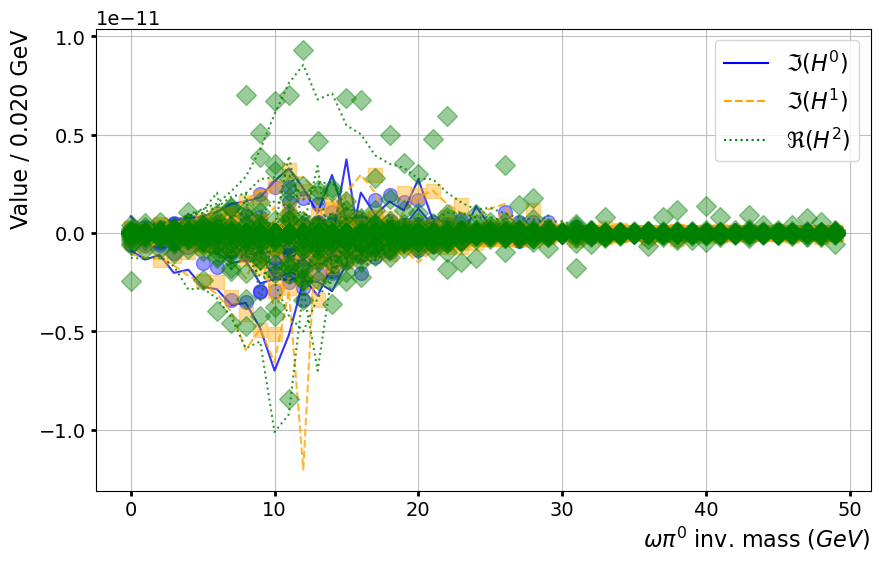

Plotting all_effects


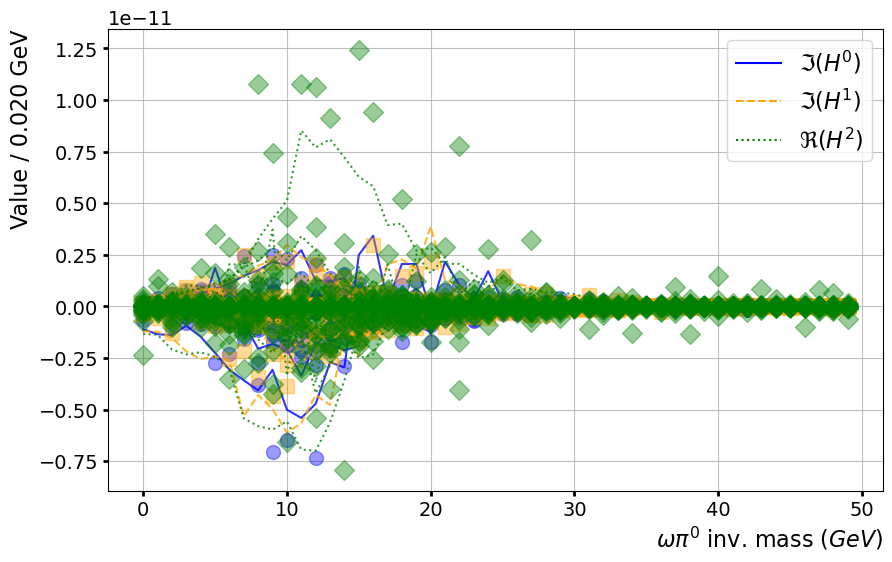

In [7]:
for key, val in all_dfs.items():
    if val["truth_moments"].shape[1] != val["fit_moments"].shape[1] or val["truth_moments"].shape[1] != val["bootstrap_moments"].shape[1]:
        raise ValueError(f"Number of moments do not match for {key}")
    if val["truth_moments"].shape[0] != val["fit_moments"].shape[0]:
        raise ValueError(f"Number of files does not match for {key}")

    h0_columns = [col for col in val["truth_moments"].columns if col.startswith("H0")]
    h1_columns = [col for col in val["truth_moments"].columns if col.startswith("H1")]
    h2_columns = [col for col in val["truth_moments"].columns if col.startswith("H2")]

    fig, ax = plt.subplots(figsize=(10, 6))
    
    mass_bins = val["data"]["m_center"]
    bin_width = (val["data"]["m_high"] - val["data"]["m_low"])[0]

    # plot truth moments with lines and fit moments as points
    val["truth_moments"][h0_columns].map(lambda x: x.imag).plot(ax=ax, linestyle="-", color="blue", alpha=0.8, legend=False)
    val["fit_moments"][h0_columns].map(lambda x: x.imag).plot(ax=ax, linestyle="", marker="o", color="blue", alpha=0.4, legend=False)
    val["truth_moments"][h1_columns].map(lambda x: x.imag).plot(ax=ax, linestyle="--", alpha=0.8, color="orange", legend=False)
    val["fit_moments"][h1_columns].map(lambda x: x.imag).plot(ax=ax, linestyle="", marker="s", color="orange", alpha=0.4, legend=False)
    val["truth_moments"][h2_columns].map(lambda x: x.real).plot(ax=ax, linestyle=":", alpha=0.8, color="green", legend=False)
    val["fit_moments"][h2_columns].map(lambda x: x.real).plot(ax=ax, linestyle="", marker="D", color="green", alpha=0.4, legend=False)

    # create some dummy lines for a nice legend
    h0_dummy = mpl.lines.Line2D([0], [0], linestyle="-", color="blue", label=r"$\Im(H^0)$")
    h1_dummy = mpl.lines.Line2D([0], [0], linestyle="--", color="orange", label=r"$\Im(H^1)$")
    h2_dummy = mpl.lines.Line2D([0], [0], linestyle=":", color="green", label=r"$\Re(H^2)$")

    ax.legend(handles=[h0_dummy, h1_dummy, h2_dummy])

    print(f"Plotting {key}")
    ax.set_xlabel(r"$\omega\pi^0$ inv. mass $(GeV)$", loc="right")
    ax.set_ylabel(f"Value / {bin_width:.3f} GeV", loc="top")
    plt.show()

Having verified this, we will make the $H^0, H^1, (H^2)$ dataframes be purely real (imaginary) to make them much easier to work with in the rest of this notebook

In [8]:
for scenario, df_dict in all_dfs.items():
    for name, df in df_dict.items():
        if "moment" not in name:
            continue
        h0_cols = [col for col in df.columns if col.startswith("H0")]
        h1_cols = [col for col in df.columns if col.startswith("H1")]
        h2_cols = [col for col in df.columns if col.startswith("H2")]

        df[h0_cols] = df[h0_cols].map(lambda x: x.real)
        df[h1_cols] = df[h1_cols].map(lambda x: x.real)
        df[h2_cols] = df[h2_cols].map(lambda x: x.imag)

        # explicitly overwrite the dataframe
        df_dict[name] = df

#### Finding non-zero moments
For our analysis we're only interested in those moments who are non-zero, so we'll use the truth moments to determine this. We'll also run a check to make sure the fit projected moments have the same set of non-zero moments as the truth moments for that scenario, and the truth moments of all other scenarios

In [9]:
tolerance = 1e-10

nonzero_moments = []
for scenario, df_dict in all_dfs.items():
    # get the nonzero columns for each scenario
    moment_columns = [col for col in df_dict["truth_moments"] if col.startswith("H")]
    scenario_nonzero_moments = [col for col in moment_columns if (df_dict["truth_moments"][col].abs() > tolerance).any()]

    # check if the nonzero columns are the same for each scenario
    if not nonzero_moments:
        nonzero_moments = scenario_nonzero_moments
    else:
        if set(nonzero_moments) != set(scenario_nonzero_moments):
            print(f"Scenario {scenario} has different nonzero moments")
            print(set(nonzero_moments) - set(scenario_nonzero_moments))

    # check if the nonzero columns are the same between truth and fit
    fit_cols = [col for col in moment_columns if (df_dict["fit_moments"][col].abs() > tolerance).any()]
    if set(scenario_nonzero_moments) != set(fit_cols):
        print(f"Scenario {scenario} has different nonzero moments between truth and fit")        
        print(set(nonzero_moments) - set(fit_cols))
        
print(f"Reducing moments for all dataframes to {len(nonzero_moments)} nonzero moment columns")
for col in nonzero_moments:
    print(col)

for scenario, df_dict in all_dfs.items():
    for name, df in df_dict.items():
        if "moment" not in name:
            continue
        non_moment_columns = [col for col in df.columns if not col.startswith("H")]        
        df_dict[name] = df[non_moment_columns + nonzero_moments]

Reducing moments for all dataframes to 42 nonzero moment columns
H0(2,0,0,0)
H0(2,2,2,1)
H1(2,0,2,1)
H1(2,0,1,1)
H2(2,0,2,1)
H1(0,0,2,0)
H0(0,0,1,1)
H1(0,0,1,1)
H1(2,2,2,0)
H1(2,1,1,0)
H0(2,0,2,1)
H2(2,1,1,1)
H2(2,1,1,0)
H1(0,0,1,0)
H1(2,2,2,1)
H1(2,1,1,1)
H0(0,0,0,0)
H0(0,0,2,0)
H2(0,0,1,1)
H1(2,0,0,0)
H1(0,0,2,1)
H0(2,0,2,0)
H0(2,1,1,1)
H0(2,0,1,0)
H0(2,1,2,0)
H0(2,0,1,1)
H1(2,0,1,0)
H2(2,0,1,1)
H2(0,0,2,1)
H2(2,2,2,0)
H2(2,1,2,0)
H0(2,1,1,0)
H0(0,0,1,0)
H1(2,0,2,0)
H2(2,2,2,1)
H1(2,1,2,0)
H0(0,0,2,1)
H2(2,1,2,1)
H1(2,1,2,1)
H1(0,0,0,0)
H0(2,2,2,0)
H0(2,1,2,1)


#### $H^0(0,0,0,0)$ =? Generated Events
The next check we can perform is to see how close the $H^0(0,0,0,0)$ moment is to the number of generated events. If all factors are handled appropriately these two should match. Below we'll plot the truth and fit $H^0(0,0,0,0)$ moments with the \# of generated events, and what scale factor these are off by (averaged over the mass bins).


Plotting thrown


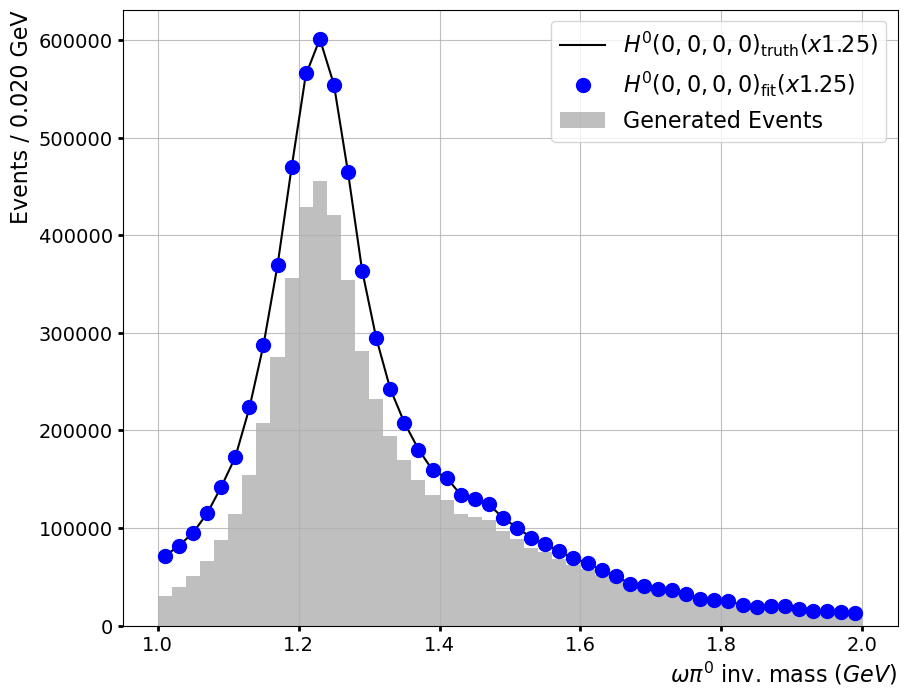

Plotting accept_noacc


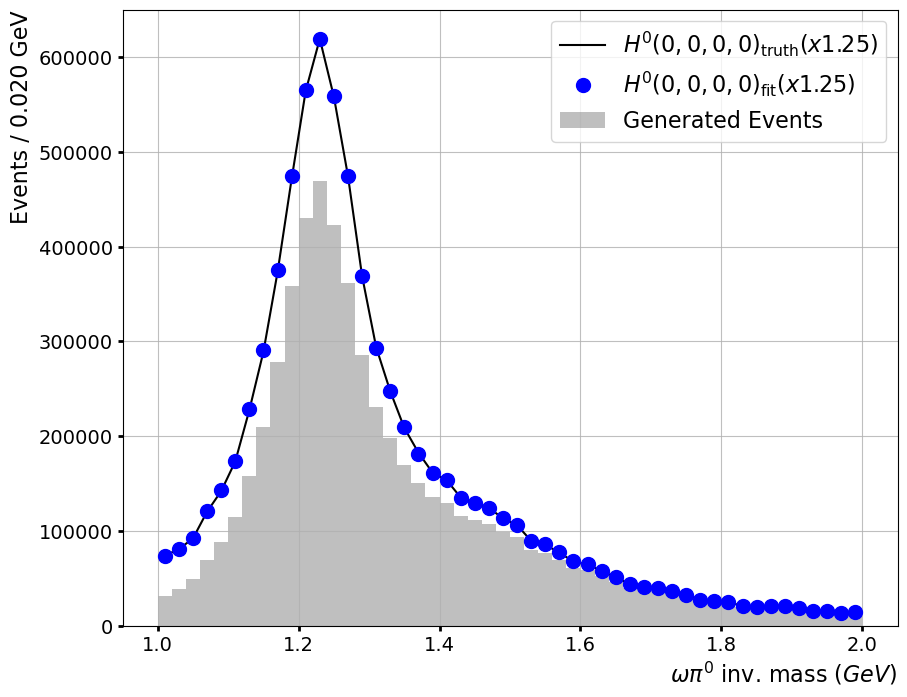

Plotting accept


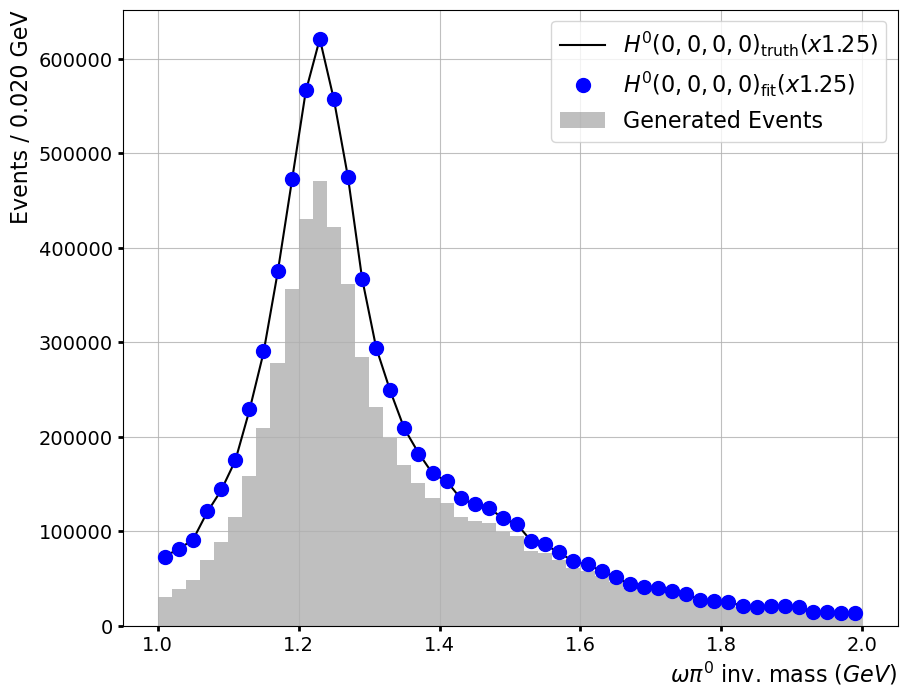

Plotting matched_noacc


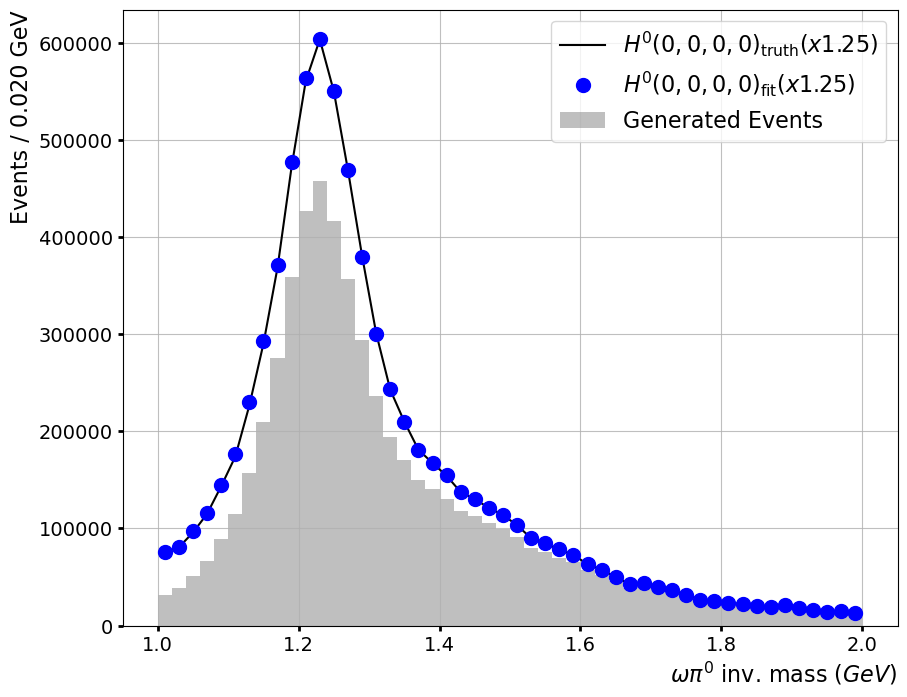

Plotting matched


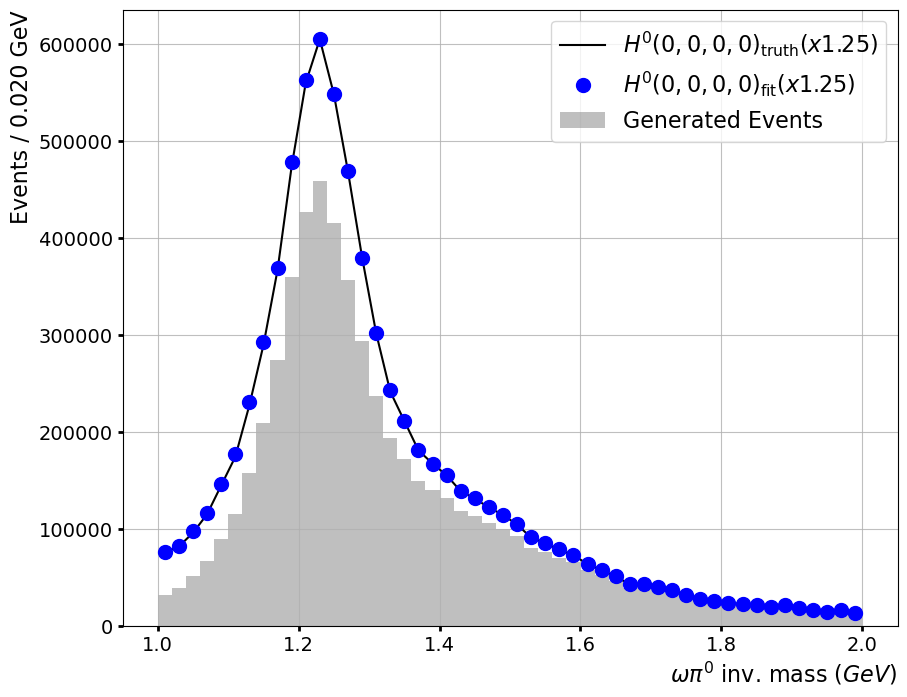

Plotting all_effects


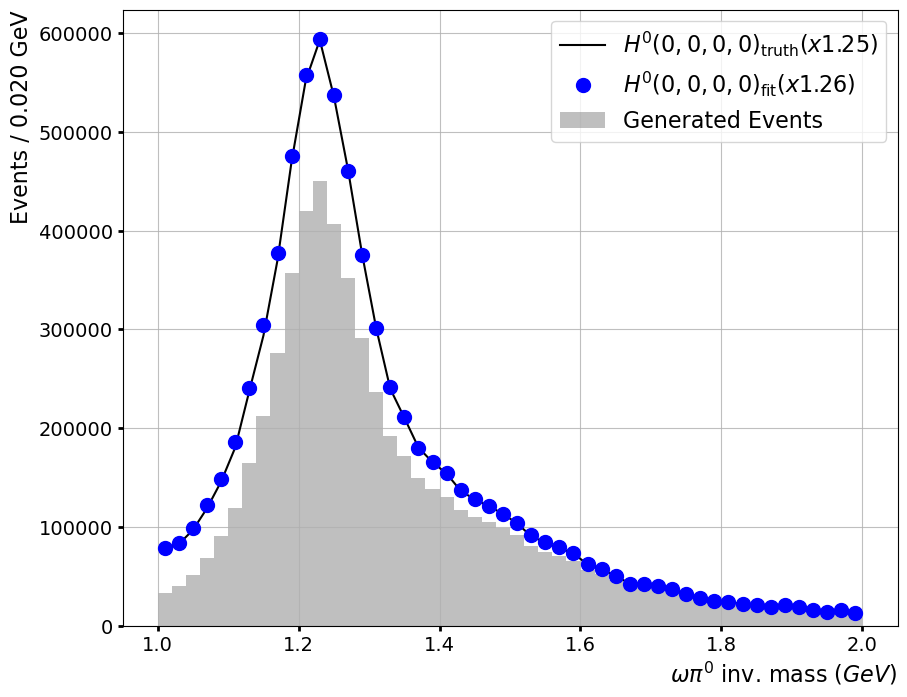

In [10]:
for scenario, df_dict in all_dfs.items():
    h0_truth = df_dict["truth_moments"]["H0(0,0,0,0)"]
    h0_fit = df_dict["fit_moments"]["H0(0,0,0,0)"]
    generated_events = df_dict["truth"]["generated_events"]

    scale_truth = (h0_truth / generated_events).mean()
    scale_fit = (h0_fit / generated_events).mean()    

    fig, ax = plt.subplots()
    mass_bins = df_dict["data"]["m_center"]
    bin_width = (df_dict["data"]["m_high"] - df_dict["data"]["m_low"])[0]

    ax.bar(mass_bins, generated_events, width=bin_width, color="gray", alpha=0.5, label="Generated Events")    
    ax.plot(mass_bins, h0_truth, color="black", marker="", linestyle="-", label=rf"$H^0(0,0,0,0)_{{\text{{truth}}}} (x{scale_truth:.2f})$")
    ax.plot(mass_bins, h0_fit, color="blue", marker="o", linestyle="", label=rf"$H^0(0,0,0,0)_{{\text{{fit}}}} (x{scale_fit:.2f})$")

    print(f"Plotting {scenario}")
    ax.set_xlabel(r"$\omega\pi^0$ inv. mass $(GeV)$", loc="right")
    ax.set_ylabel(f"Events / {bin_width:.3f} GeV", loc="top")    
    ax.legend(loc="upper right")

    plt.show()


#### Normalization
We will use normalized moments
$$
\hat{H}^\alpha(J_v,\Lambda,J,M) = \frac{H^\alpha(J_v,\Lambda,J,M)}{H^0(0,0,0,0)}.
$$ 
for the rest of our analysis, as it will account for what appears to be an overall common scale factor thats missing for each scenario. This also accounts for differences in the number of events for each scenario.

In [11]:
def normalize_moments(df: pd.DataFrame) -> pd.DataFrame:
    
    # avoid normalizing already normalized data   
    if (df["H0(0,0,0,0)"] == 1).all():             
        return df
    
    # normalize the moments by dividing by the H0(0,0,0,0) column, but avoid making the H0 column 1 too early in the loop
    moment_cols = [col for col in df.columns if col.startswith("H") and col != "H0(0,0,0,0)"]
    for col in moment_cols:           
        df[col] = df[col].div(df["H0(0,0,0,0)"])
    df["H0(0,0,0,0)"] = df["H0(0,0,0,0)"].div(df["H0(0,0,0,0)"])
    
    return df

for scenario, df_dict in all_dfs.items():
    for key, df in df_dict.items():
        if "moment" not in key:
            continue        
        df_dict[key] = normalize_moments(df)

#### Getting errors from the bootstrap distributions
The bootstrap values provide a better approximation of the error for the amplitudes. In the case of the moments, we cannot easily propagate the MINUIT production coefficient errors to the moments, and so the bootstrap provides the only error. Before using them, we want to make sure they're roughly gaussian distributed by using a [Shapiro-Wilk test](https://en.wikipedia.org/wiki/Shapiro%E2%80%93Wilk_test) and ensuring that its resultant p-values are greater than 0.05. 

Distributions that do not pass this tests are plotted on a probability plot, grouped by mass bin and scenario, and saved to a pdf. These probability plots, made using `scipy.stats.probplot`, are the same as Q-Q plots [(despite what the documentation implies)](https://stackoverflow.com/questions/48108582/how-to-interpret-scipy-stats-probplot-results). Deviations from the best fit line indicate that the bootstrap distribution is not similar to a normal distribution, and we should be wary of using its standard deviation as an estimation of the error.

In [12]:
from matplotlib.backends.backend_pdf import PdfPages
def shapiro_test(grouped_df:pd.DataFrame, columns:list, pdf: PdfPages) -> None:
    # test the normality of the bootstrap data, grouped by file name

    # use dict of dicts to store { col : {scenario : p-value} } for distributions that are not normal
    non_normal_dict = {}
    for col in columns:     
        for scenario in grouped_df['scenario'].unique():   
            stat, p_value = scipy.stats.shapiro(grouped_df[grouped_df['scenario'] == scenario][col])        
            if p_value < 0.05:
                non_normal_dict.setdefault(col, {})[scenario] = p_value

    # Plot the non-normal columns
    if non_normal_dict:
        # setup the subplots to be a square grid
        num_plots = len(non_normal_dict)
        num_cols = math.ceil(math.sqrt(num_plots))
        num_rows = math.ceil(num_plots / num_cols)
        
        fig, axes = plt.subplots(num_rows, num_cols, figsize=(num_cols * 5, num_rows * 5))
        axes = axes.flatten() if num_plots > 1 else [axes]
        
        # plot all non-normal scenarios on the same plot
        for ax, (col, scenario_dict) in zip(axes, non_normal_dict.items()):
            for scenario, p_value in scenario_dict.items():
                scipy.stats.probplot(grouped_df[grouped_df['scenario'] == scenario][col], dist="norm", plot=ax)

                ax.set_title(f"{col}")                    
                best_fit_line = ax.get_lines()[-1] # always plotted last
                data_markers = ax.get_lines()[-2]
                
                # change markers and best fit line to a color for that scenario
                best_fit_line.set_color(SCENARIO_COLORS[scenario])
                data_markers.set_markerfacecolor(SCENARIO_COLORS[scenario])
                data_markers.set_markeredgecolor(SCENARIO_COLORS[scenario])
                data_markers.set_marker(SCENARIO_MARKERS[scenario])
                data_markers.set_label(f"{scenario}:{p_value:.1e}")
                data_markers.set_alpha(0.6)
                ax.legend(loc="lower right", fontsize=10)

        # create a figure legend explaining the scenario colors
        handles = [
            mpl.patches.Patch(color=color, label=scenario)
            for scenario, color in SCENARIO_COLORS.items()
        ]
        legend = fig.legend(
            handles=handles, loc="center left", title=f"mass = {grouped_df.name}",
            ncol=1, bbox_to_anchor=(1, 0.5)
        )

        # Hide any unused subplots
        for ax in axes[num_plots:]:
            ax.set_visible(False)
        
        plt.tight_layout(rect=[0, 0, 1.0 , 1.0])        
        pdf.savefig(fig, bbox_extra_artists=(legend,), bbox_inches="tight")
        plt.close()

# setup dataframes to hold all the bootstrap data, with their scenarios labelled
all_bootstrap = pd.DataFrame()   
all_bootstrap_moment = pd.DataFrame()    
for scenario, df_dict in all_dfs.items():
    # use dataframe copies to avoid modifying the original dataframes
    copy_df = df_dict["bootstrap"].copy()
    copy_moment_df = df_dict["bootstrap_moments"].copy()
    copy_moment_df["scenario"] = scenario        
    copy_df["scenario"] = scenario

    all_bootstrap_moment = pd.concat([all_bootstrap_moment, copy_moment_df])
    all_bootstrap = pd.concat([all_bootstrap, copy_df])

del copy_moment_df
del copy_df

# we only apply this to the moments, since the amplitudes are bound to be >0, and phase differences 
# are circular data, making this test not very useful for them. 
# We'll need to apply a different test for those in the future.
moment_columns = [col for col in all_bootstrap_moment.columns if col.startswith("H")]
grouped_bootstrap_moments_df = all_bootstrap_moment.groupby("mass")

# apply the shapiro test to the grouped dataframe, and save all figs into a pdf
with PdfPages("shapiro_bootstrap_moments.pdf") as pdf:        
    grouped_bootstrap_moments_df.apply(
        shapiro_test, 
        columns=moment_columns, pdf=pdf, 
        include_groups=False
    )
    print(f"Shapiro test results for bootstrapped moments saved to: {os.path.join(WORKING_DIR, 'shapiro_bootstrap_moments.pdf')}")

# Explicitly delete the grouped dataframe for memory
del grouped_bootstrap_moments_df

/home/kscheuer/work/miniforge3/envs/neutralb1/lib/python3.12/site-packages/scipy/stats/_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: Input data has range zero. The results may not be accurate.
  res = hypotest_fun_out(*samples, **kwds)


Shapiro test results for bootstrapped moments saved to: /w/halld-scshelf2101/kscheuer/neutralb1/analysis/input-output-tests/moment-projection/shapiro_bootstrap_moments.pdf


The distributions look quite good, with no flat or bi-modal solutions seeming to occur. But we must be careful, as normality does not guarantee our distributions are centered near the moment value of the total sample. Lets quickly check that this is the case by comparing the log transformed difference of the moment value and bootstrap mean. 

In [13]:
# Group by "scenario" and "mass" and calculate the mean for each grouping
# we'll avoid the (circular data) phase differences for now
amp_columns = [item for sublist in pwa_tools.get_coherent_sums(all_bootstrap).values() for item in sublist]
amp_columns += ["mass", "scenario"]
mean = all_bootstrap[amp_columns].groupby(["mass", "scenario"]).mean().reset_index()
mean_moments = all_bootstrap_moment.drop(columns="file").groupby(["mass", "scenario"]).mean().reset_index()

for scenario, df_dict in all_dfs.items():
    # get the mean dataframes for each scenario
    mean_scenario = mean[mean["scenario"] == scenario]
    mean_moments_scenario = mean_moments[mean_moments["scenario"] == scenario]

    # get the fit dataframes for each scenario
    fit = df_dict["fit"]
    fit_moments = df_dict["fit_moments"]

    # merge the mean dataframes with the fit dataframes
    mean_scenario = mean_scenario.merge(fit, on="mass", suffixes=("_mean", "_fit"))
    mean_moments_scenario = mean_moments_scenario.merge(fit_moments, on="mass", suffixes=("_mean", "_fit"))

    # calculate the log-transformed differences between the mean and fit dataframes
    for col in mean_scenario.columns:
        if col.endswith("_mean"):
            fit_col = col.replace("_mean", "_fit")
            diff_col = col.replace("_mean", "_log_diff")
            mean_scenario[diff_col] = np.log1p(mean_scenario[col]) - np.log1p(mean_scenario[fit_col])

    for col in mean_moments_scenario.columns:
        if col.endswith("_mean"):
            fit_col = col.replace("_mean", "_fit")
            diff_col = col.replace("_mean", "_log_diff")
            mean_moments_scenario[diff_col] = np.log1p(mean_moments_scenario[col]) - np.log1p(mean_moments_scenario[fit_col])

    # print any log-transformed difference that exceeds a ~10% threshold for the original data
    threshold = 0.1
    for col in mean_moments_scenario.columns:
        if col.endswith("_log_diff"):
            if mean_moments_scenario[col].abs().max() > threshold:
                print(f"{scenario} {col} exceeds log-transformed difference threshold")
                print(mean_moments_scenario[["mass", col]])

Now we can use the bootstrap standard deviations as the errors for our moments.

In [14]:
# Group by "scenario" and "mass" and calculate the standard deviation for each grouping
# we only want to use the bootstrap errors for the amplitude values, because the phase standard deviations aren't properly done
amp_columns = [item for sublist in pwa_tools.get_coherent_sums(all_bootstrap).values() for item in sublist]
amp_columns += ["mass", "scenario"]
std_dev = all_bootstrap[amp_columns].groupby(["mass", "scenario"]).std().reset_index()
std_dev_moments = all_bootstrap_moment.drop(columns="file").groupby(["mass", "scenario"]).std().reset_index()

# add the standard deviations as errors to the fit dataframes
for scenario, df_dict in all_dfs.items():
    scenario_std_dev = std_dev[std_dev["scenario"] == scenario].drop(columns="scenario")
    scenario_std_dev_moments = std_dev_moments[std_dev_moments["scenario"] == scenario].drop(columns="scenario")

    # drop the old error columns for the amplitude fits
    amp_columns_errs = [f"{col}_err" for col in amp_columns if col not in ["mass", "scenario"]]
    df_dict["fit"] = df_dict["fit"].loc[:, ~df_dict["fit"].columns.isin([c for c in amp_columns_errs if c in df_dict["fit"].columns])]

    # merge the standard deviation dataframes with the fit dataframes, this ensures the masses match correctly
    df_dict["fit"] = df_dict["fit"].merge(
        scenario_std_dev,
        on=["mass"],
        suffixes=("", "_err"),
    )
    df_dict["fit_moments"] = df_dict["fit_moments"].merge(
        scenario_std_dev_moments,
        on=["mass"],
        suffixes=("", "_err"),
    )

# delete these now that we're done with them
del std_dev
del std_dev_moments
del scenario_std_dev
del scenario_std_dev_moments
del all_bootstrap
del all_bootstrap_moment

#### Truth Moments Vs Detector Effects
We don't expect the truth moments to change for each detector effect, so we can plot them to check that they're shape is identical across the mass bins

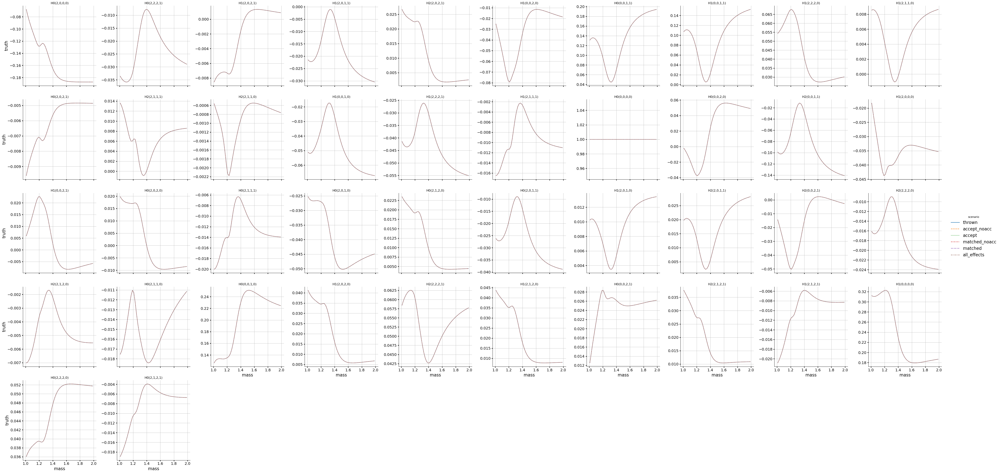

In [15]:
# setup a dataframe to store the truth moments for each scenario
truth_df = pd.DataFrame()

for scenario, df_dict in all_dfs.items():
    cols = [col for col in df_dict["truth_moments"].columns if col.startswith("H")]

    # add those truth moments to the dataframe with the mass and scenario
    df = pd.concat([df_dict["data"]["m_center"], df_dict["truth_moments"][cols]], axis=1)
    df.rename(columns={"m_center": "mass"}, inplace=True)
    df["scenario"] = scenario
    truth_df = pd.concat([truth_df, df])

# plot the relative truth moments for each scenario
truth_df_melted = truth_df.melt(id_vars=["mass", "scenario"], var_name="moment", value_name="truth")
grid = sns.relplot(
    data=truth_df_melted, x="mass", y="truth", col="moment", 
    col_wrap=10, kind="line", hue="scenario", style="scenario", facet_kws={'sharey': False}
)

for ax in grid.axes.flat:
    # remove the "moment = " from the title
    subplot_title = ax.get_title()
    ax.set_title(subplot_title.replace("moment = ", ""))
    # set the alpha value of each line
    for line in ax.get_lines():
        scenario = line.get_label()
        if scenario == "thrown":
            line.set_alpha(1.0)
        else:
            line.set_alpha(0.4)
plt.show()


## Analysis
With our data verified and processed, lets move onto some analysis

### Standard Amplitude and Moment Plots
We'll start off by making some standard plots, such as the moments and amplitudes as a function of mass 

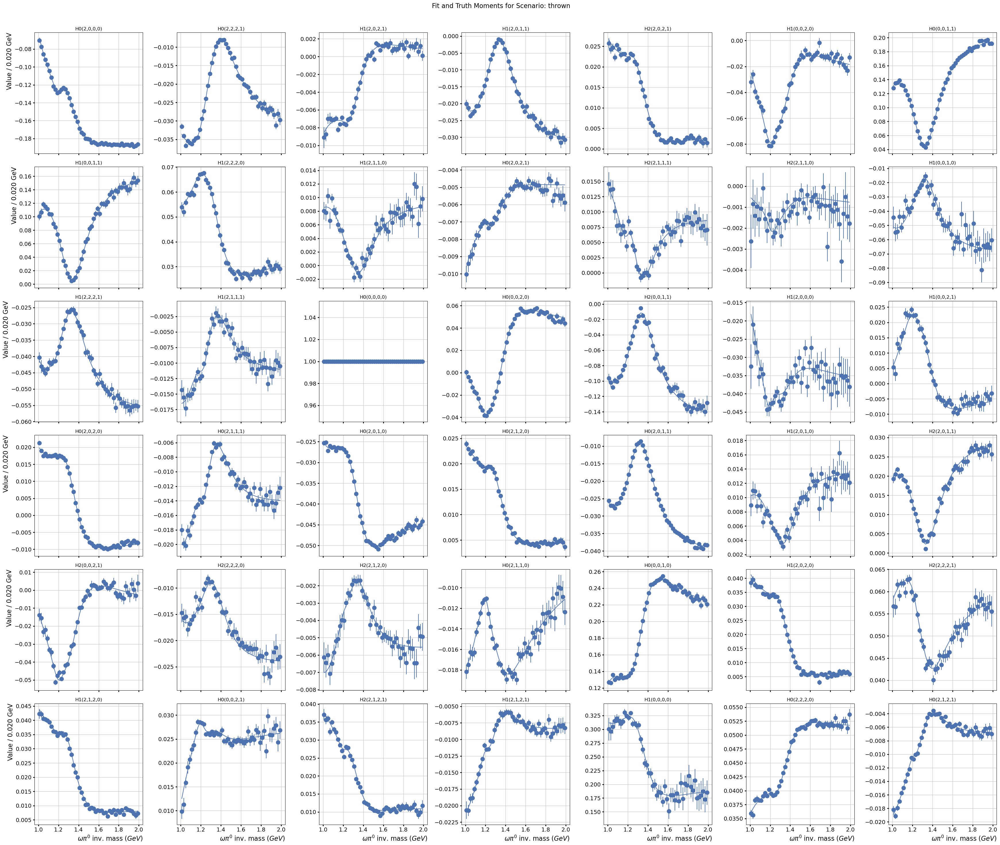

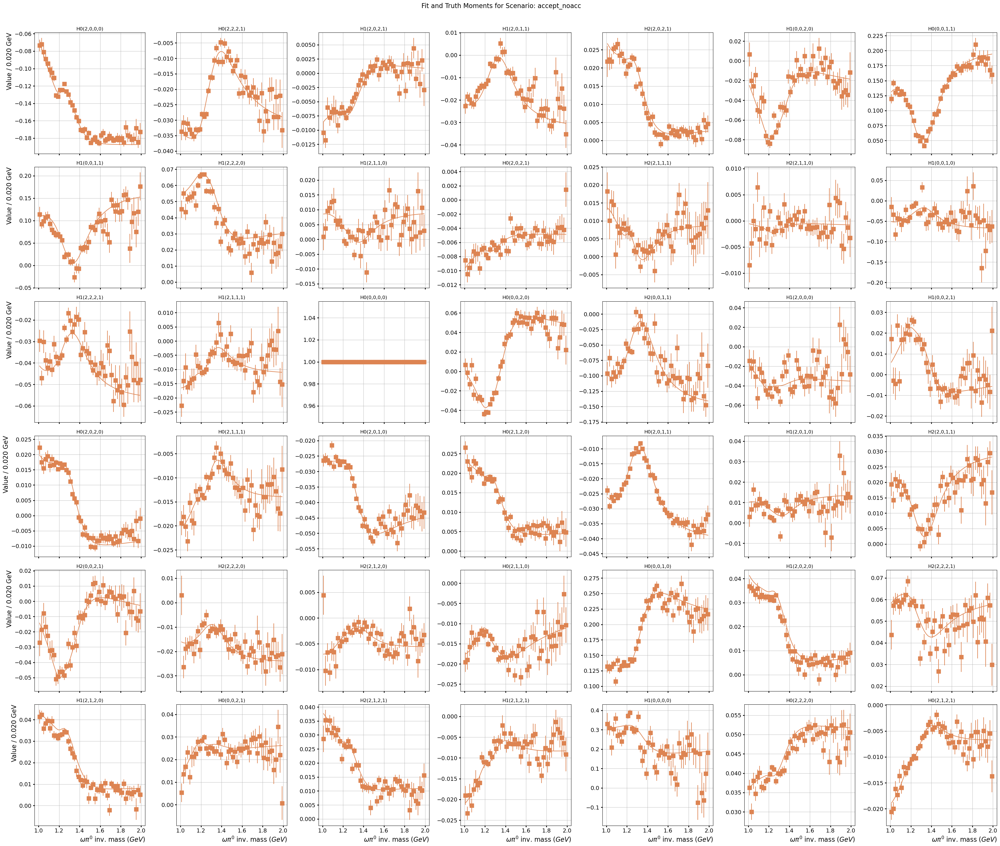

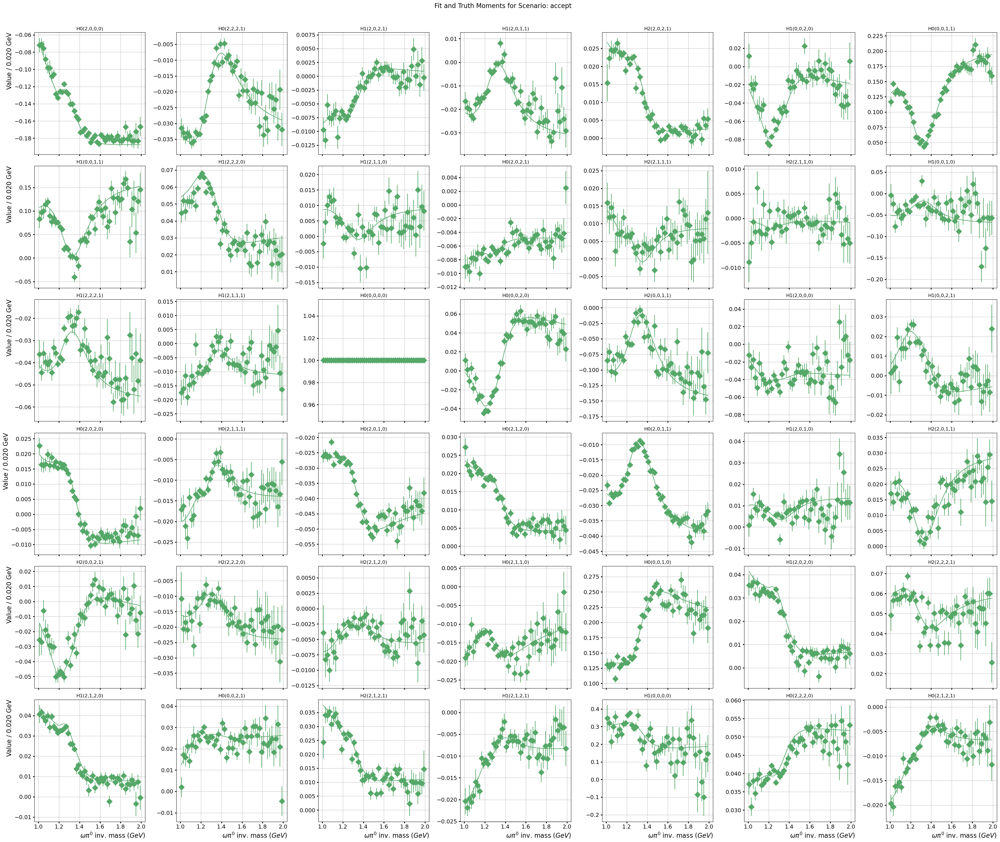

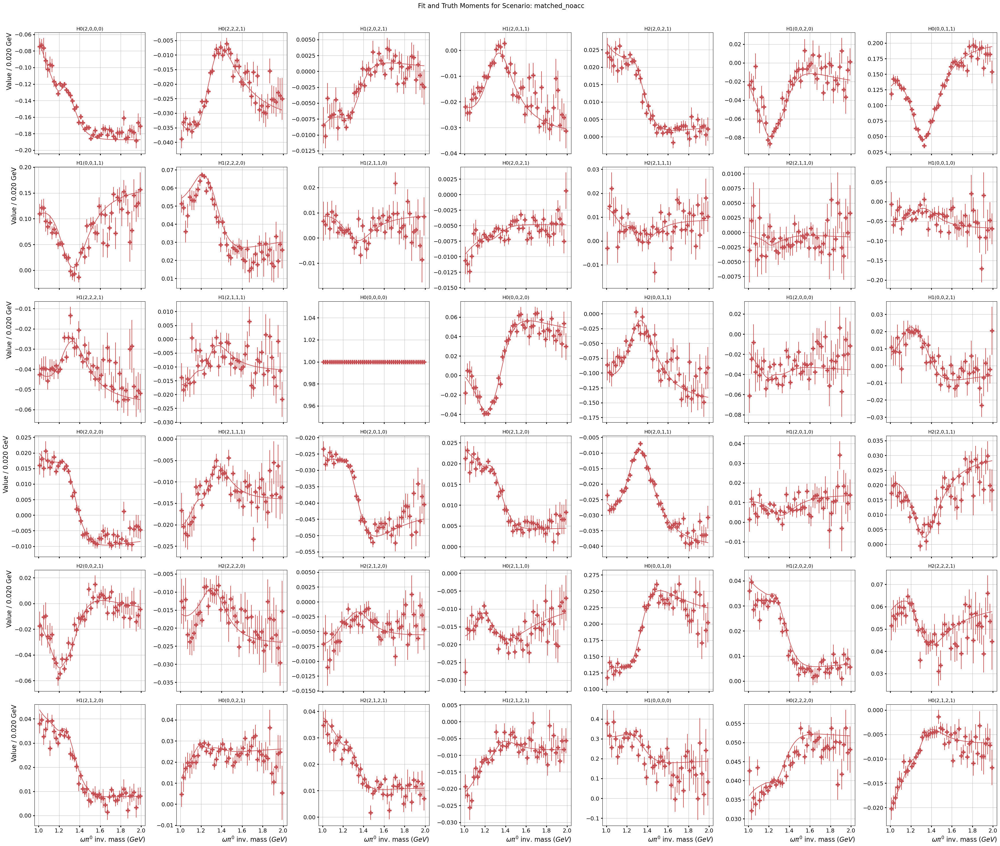

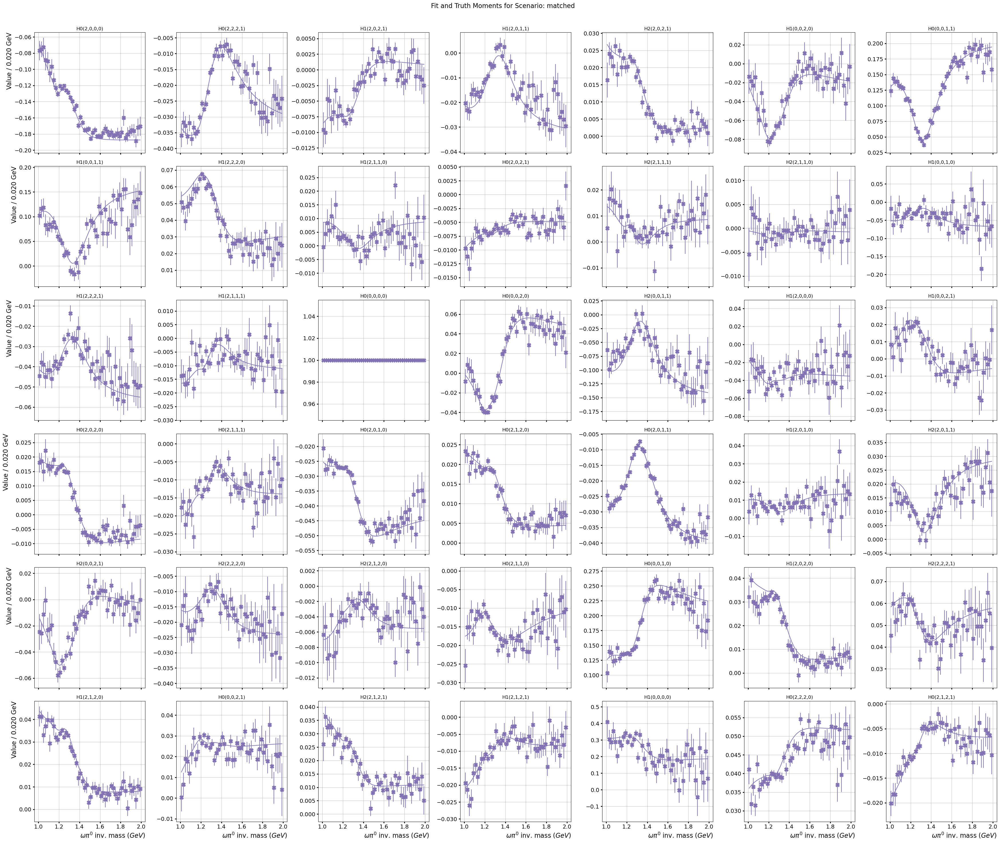

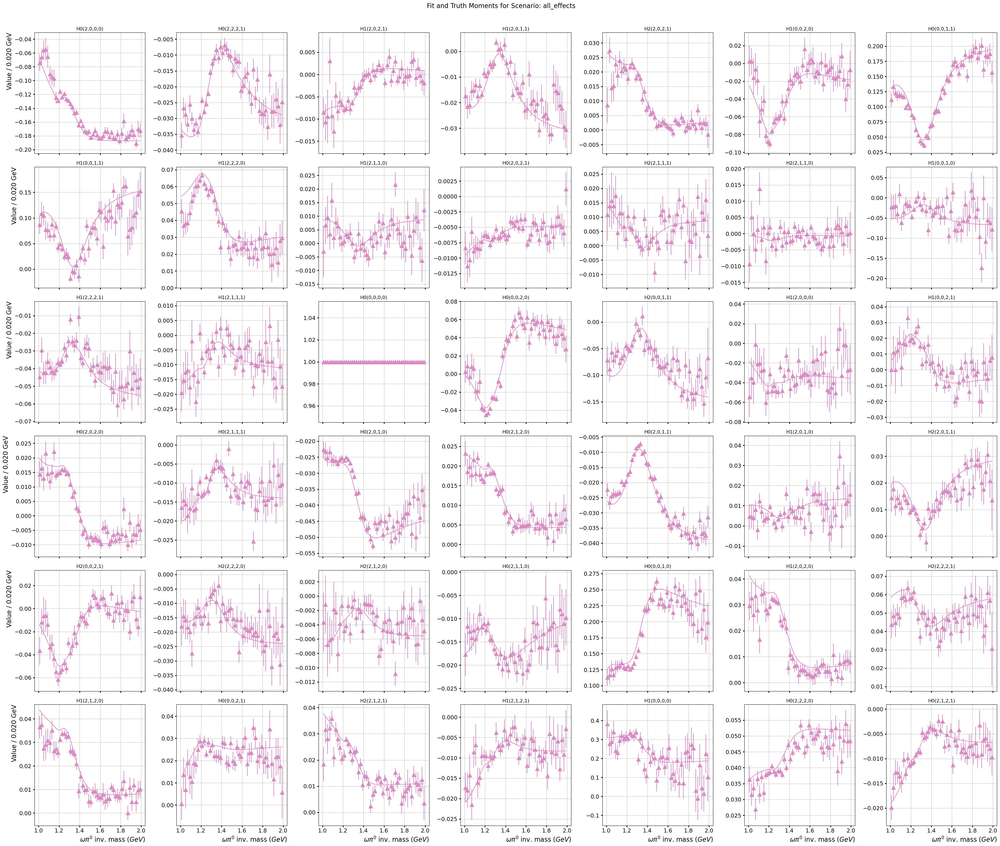

In [16]:
# plot the fit and truth moments as a function of mass, for each scenario
for scenario, df_dict in all_dfs.items():
    truth_moments = df_dict["truth_moments"]
    fit_moments = df_dict["fit_moments"]

    moment_cols = [c for c in truth_moments.columns if c.startswith("H")]
    num_plots = len(moment_cols)
    num_cols = math.ceil(math.sqrt(num_plots))
    num_rows = math.ceil(num_plots / num_cols)
    
    fig, axes = plt.subplots(
        num_rows, num_cols, 
        figsize=(num_cols * 5, num_rows * 5),
        sharex=True
    )
    axes = axes.flatten() if num_plots > 1 else [axes]

    for i, moment in enumerate(moment_columns):
        ax = axes[i]
        mass = df_dict["data"]["m_center"]
        bin_width = (df_dict["data"]["m_high"] - df_dict["data"]["m_low"]).iloc[0]

        fit_values = fit_moments[moment]
        fit_errors = fit_moments[f"{moment}_err"]
        
        ax.errorbar(
            x=mass, y=fit_values, yerr=fit_errors,
            color=SCENARIO_COLORS[scenario], marker=SCENARIO_MARKERS[scenario],
            linestyle="", clip_on=True
        )
        ax.plot(
            mass, truth_moments[moment], 
            color=SCENARIO_COLORS[scenario], marker="", linestyle="-"
        )
        ax.set_title(moment)

        if i >= num_plots - num_cols: # set xlabel for last plot of columns
            ax.set_xlabel(r"$\omega\pi^0$ inv. mass $(GeV)$", loc="right")
        if i % num_cols == 0: # set ylabel for first column
            ax.set_ylabel(f"Value / {bin_width:.3f} GeV", loc="top")
        ax.grid(True)
    
    # Hide any unused subplots
    for ax in axes[num_plots:]:
        ax.set_visible(False)

    fig.suptitle(f"Fit and Truth Moments for Scenario: {scenario}", fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.97])
    plt.show()    

Now lets make some plots of the individual amplitudes

/w/halld-scshelf2101/kscheuer/neutralb1/analysis/scripts/pwa_tools.py:69: UserWarning: the following indices contain fit results whose covariance matrix is not full and accurate.
  warnings.warn(


2     2
8     2
20    2
21    2
30    2
45    2
Name: eMatrixStatus, dtype: int64
Creating plots for the scenario: thrown


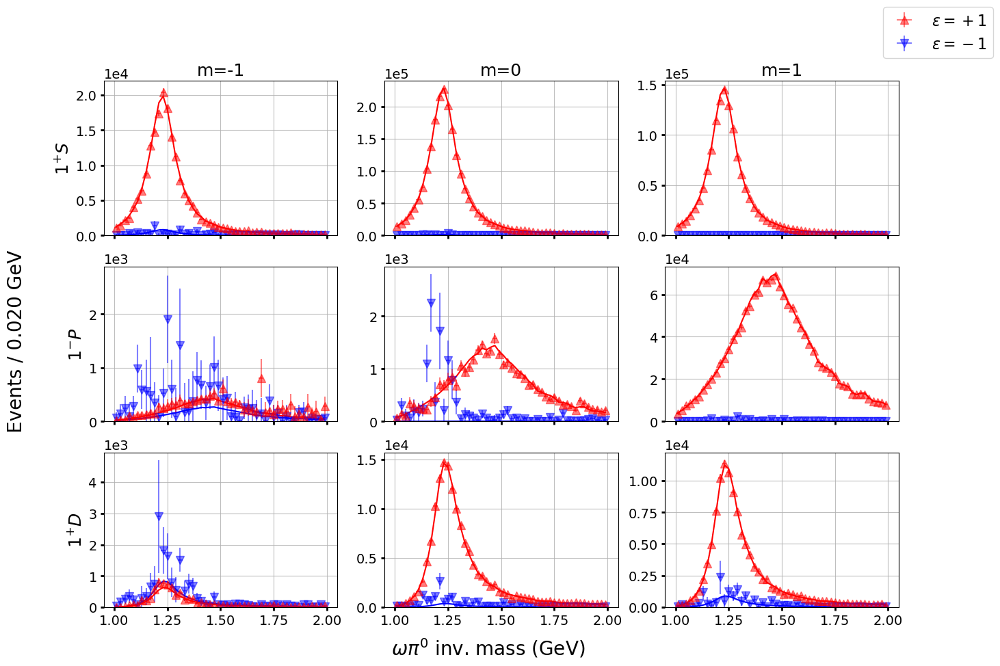

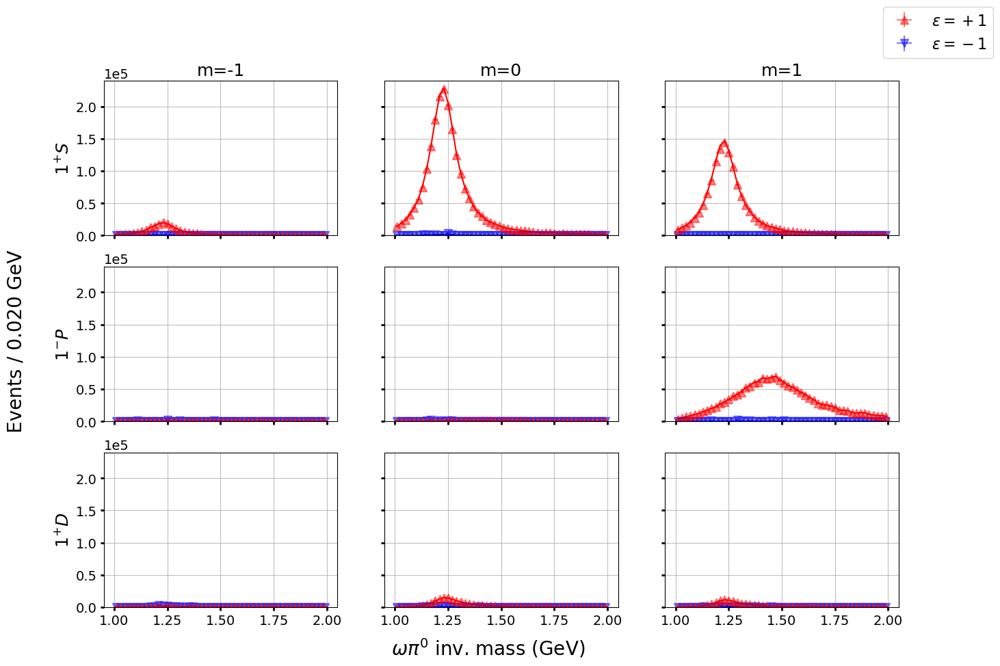

/w/halld-scshelf2101/kscheuer/neutralb1/analysis/scripts/pwa_tools.py:69: UserWarning: the following indices contain fit results whose covariance matrix is not full and accurate.
  warnings.warn(


1     2
5     2
19    2
25    2
26    2
30    2
32    2
35    2
38    2
39    2
40    2
41    2
42    2
46    2
48    2
Name: eMatrixStatus, dtype: int64
Creating plots for the scenario: accept_noacc


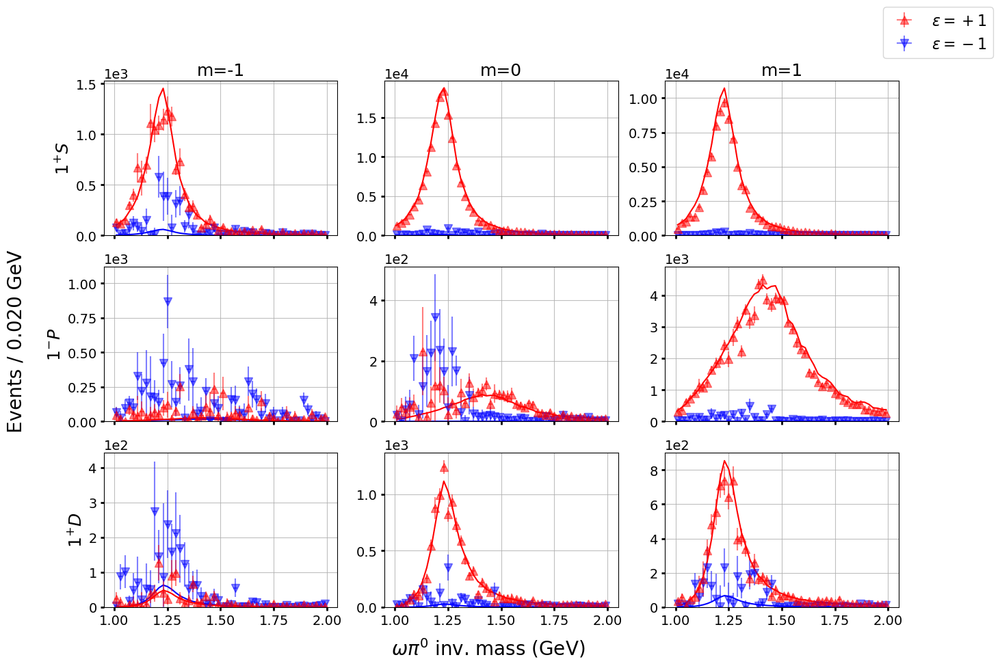

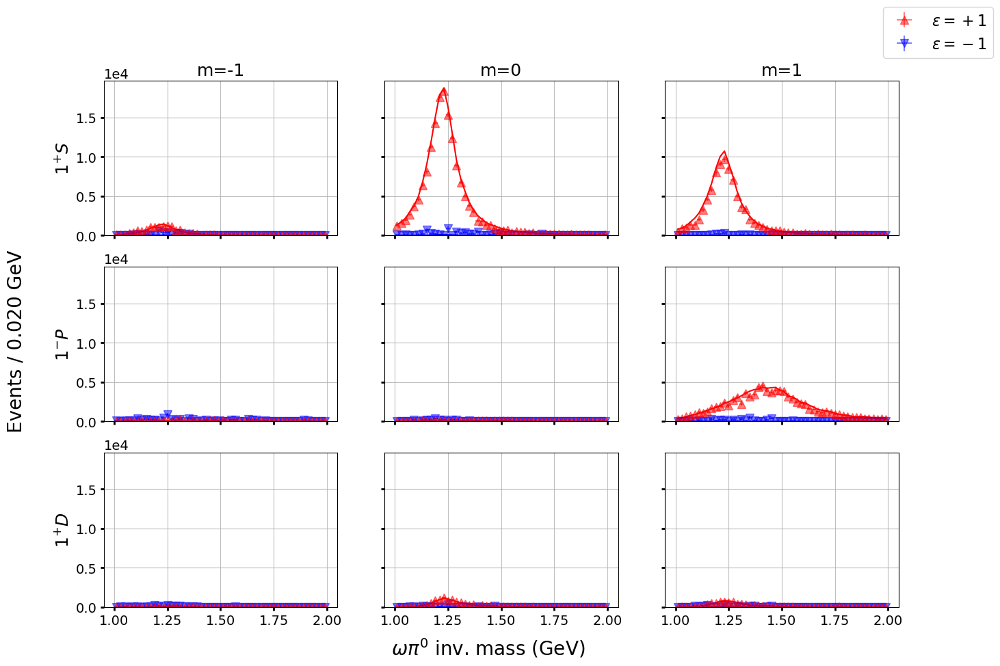

/w/halld-scshelf2101/kscheuer/neutralb1/analysis/scripts/pwa_tools.py:69: UserWarning: the following indices contain fit results whose covariance matrix is not full and accurate.
  warnings.warn(


25    2
27    2
30    2
32    2
34    2
36    2
37    2
38    2
41    2
42    2
43    2
46    2
47    2
48    2
49    2
Name: eMatrixStatus, dtype: int64
Creating plots for the scenario: accept


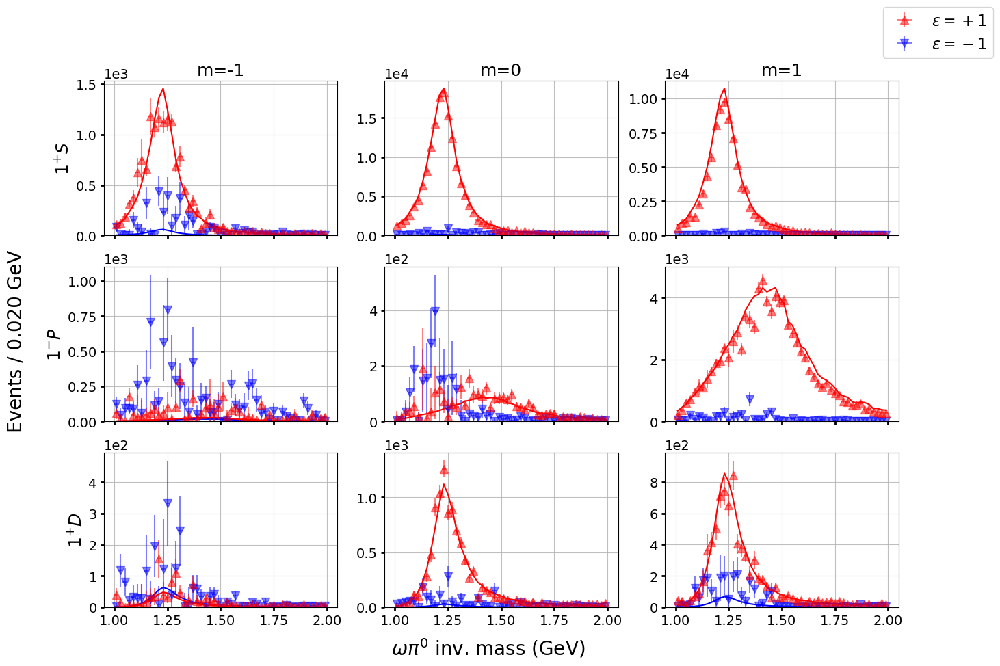

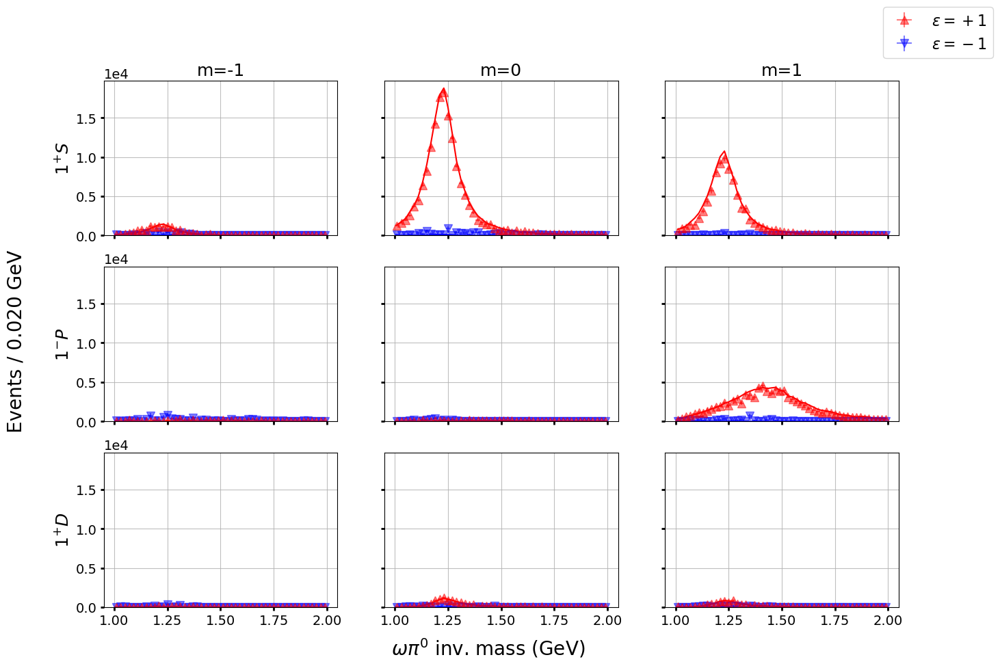

/w/halld-scshelf2101/kscheuer/neutralb1/analysis/scripts/pwa_tools.py:69: UserWarning: the following indices contain fit results whose covariance matrix is not full and accurate.
  warnings.warn(


1     2
3     2
13    2
26    2
27    2
28    2
30    2
32    2
34    2
37    2
38    2
39    2
40    2
41    2
42    2
45    2
46    2
48    2
Name: eMatrixStatus, dtype: int64
Creating plots for the scenario: matched_noacc


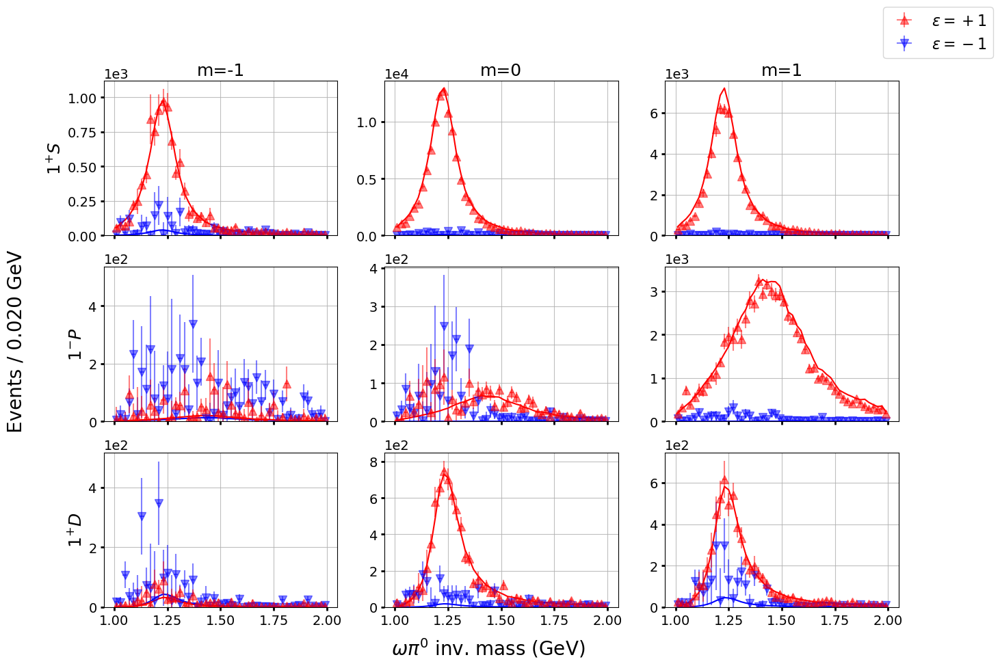

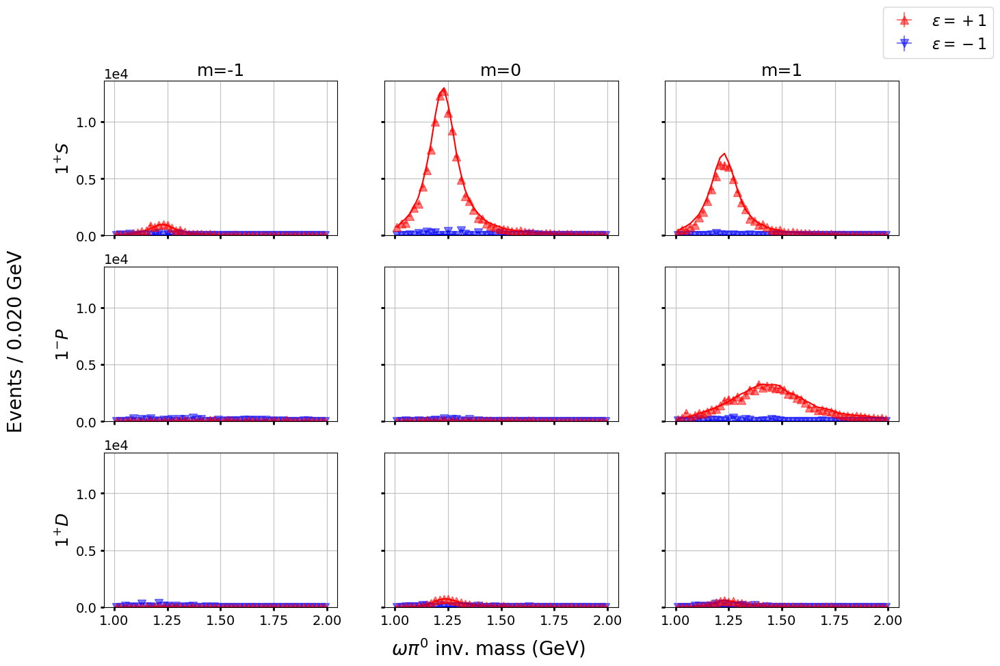

/w/halld-scshelf2101/kscheuer/neutralb1/analysis/scripts/pwa_tools.py:69: UserWarning: the following indices contain fit results whose covariance matrix is not full and accurate.
  warnings.warn(


1     2
2     2
16    2
25    2
26    2
32    2
33    2
35    2
36    2
41    2
42    2
43    2
44    2
45    2
46    2
47    2
48    2
Name: eMatrixStatus, dtype: int64
Creating plots for the scenario: matched


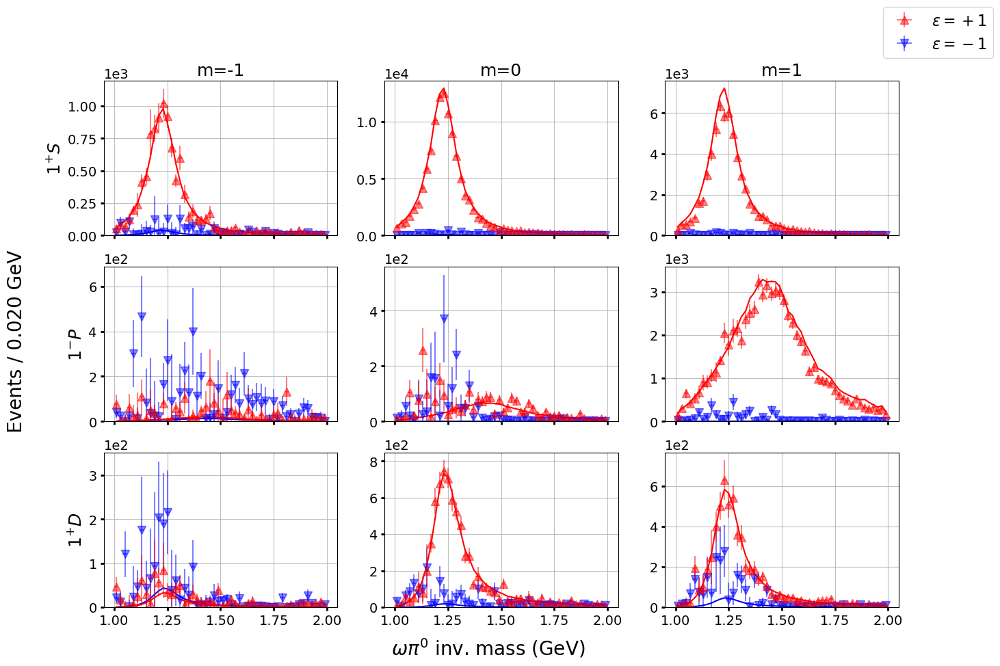

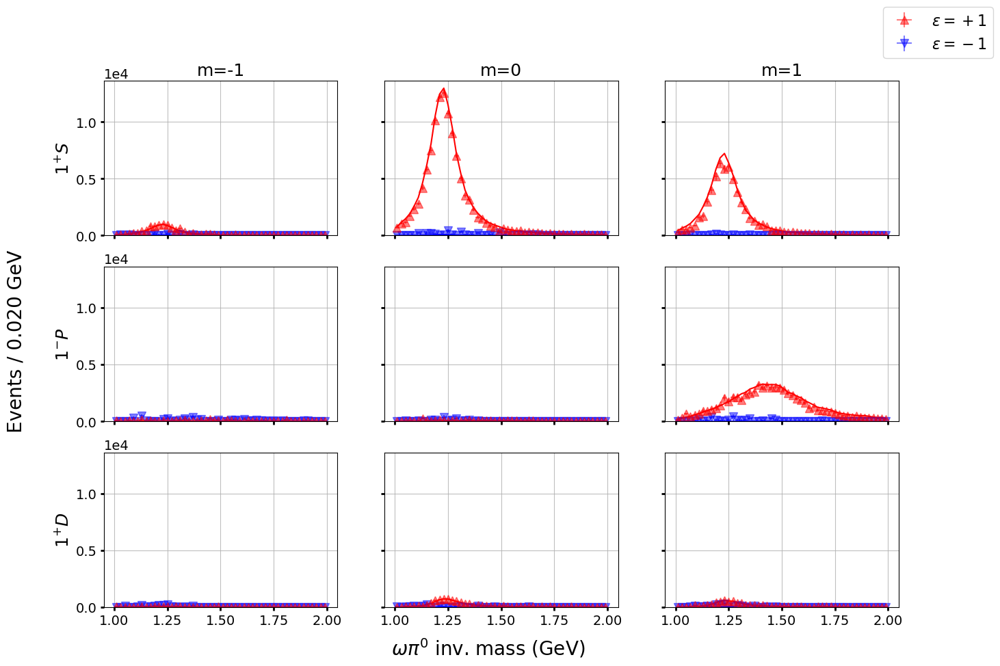

/w/halld-scshelf2101/kscheuer/neutralb1/analysis/scripts/pwa_tools.py:69: UserWarning: the following indices contain fit results whose covariance matrix is not full and accurate.
  warnings.warn(


19    2
20    2
25    2
26    2
28    2
32    2
33    2
34    2
35    2
36    2
38    2
40    2
41    2
42    2
44    2
45    2
48    2
Name: eMatrixStatus, dtype: int64
Creating plots for the scenario: all_effects


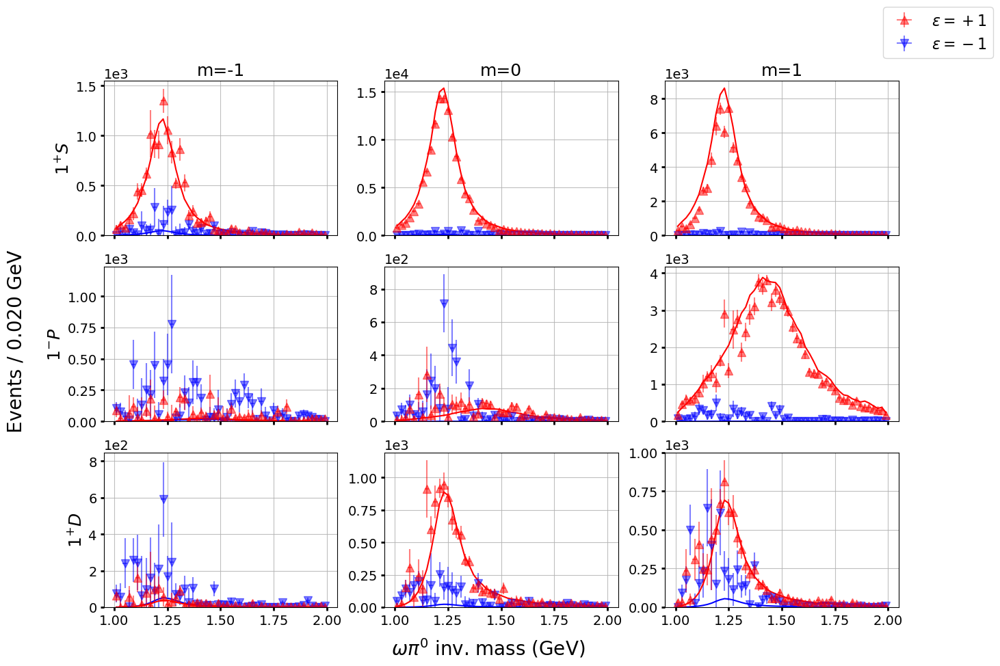

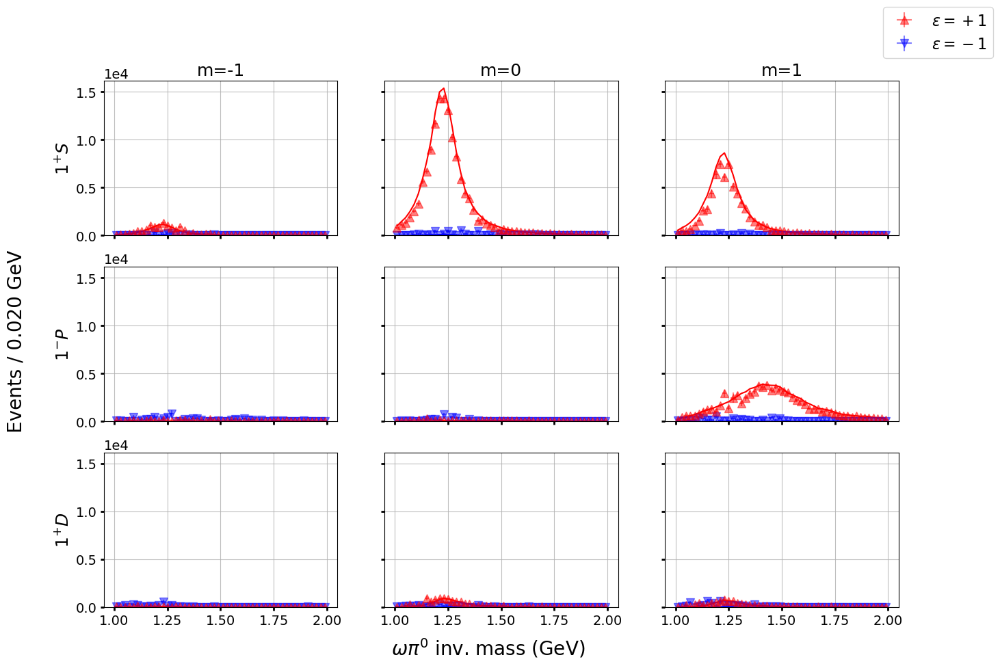

In [17]:
for scenario, df_dict in all_dfs.items():
    plotter = pwa_tools.Plotter(df_dict["fit"], df_dict["data"], truth_df=df_dict["truth"])
    print(f"Creating plots for the scenario: {scenario}")    
    plotter.intensities()
    plotter.intensities(sharey=True)

### Moment Residuals and Reduced $\chi^2$ 
As we discussed in the introduction, if the moments projected from the fit results are *close* to the true moment values, then we can say with some certainty that our amplitude fit results are part of an ambiguous set of continuous solutions that include the true amplitude values. So how do we quantify "close"? Well the most straightforward way is a reduced chi-squared
$$
\frac{\chi^2}{\text{ndf}} = \frac{1}{\text{ndf}} \sum_{\alpha,J_v,\Lambda,J,M} \left(
    \frac{
        \hat{H}^\alpha(J_v,\Lambda,J,M)^{\text{truth}} - \hat{H}^\alpha(J_v,\Lambda,J,M)^{\text{fit}}
    }{
        \sigma_{\hat{H}}^{\text{fit}}
    }
\right)^2\,,
$$
for some number of degrees of freedom $\text{ndf}$. This statistic is weighted by the errors $\sigma_{\hat{H}}^{\text{fit}}$ , which we obtained via the bootstrap distributions. Note that we are currently assuming the covariance of the moments to be 0, which we may want to incorporate into this calculation in the future. We can separate the result of $\chi^2/\text{ndf}$ into 2 broad categories
1. $\chi^2/\text{ndf} >> 1$: The fit projected moment set is different from the truth values, and thus the amplitude fits are a unique solution that is different from the true amplitudes
2. $\chi^2/\text{ndf} \approx 1$: The difference between the true and fit projected moments are within the variance, and so the its likely that the amplitude fits and true amplitudes are both equally valid descriptions of the data. If the fit and true amplitudes differ, then this is a case of continuous ambiguities.

In [18]:
moment_columns = [col for col in all_dfs["thrown"]["truth_moments"].columns if col.startswith("H") and not col.endswith("_err")]

# create total dataframes for every scenario
residual_df = pd.DataFrame()
weighted_residual_df = pd.DataFrame()
reduced_chi2_df = pd.DataFrame()

for scenario, df_dict in all_dfs.items():
    # calculate the residual for each moment
    scenario_residual_df = df_dict["truth_moments"][moment_columns].sub(df_dict["fit_moments"][moment_columns])
    
    # calculated weighted residuals with the proper error
    scenario_weighted_df = scenario_residual_df.copy()
    for col in scenario_weighted_df.columns:
        scenario_weighted_df[col] = scenario_weighted_df[col].div(df_dict["fit_moments"][f"{col}_err"])

    # calculate chi2 for the scenario
    scenario_chi2 = (scenario_weighted_df ** 2).sum(axis=1) / (scenario_weighted_df.count(axis=1))

    # add the scenario and mass labels to the dataframes
    scenario_residual_df["scenario"] = scenario
    scenario_residual_df["mass"] = df_dict["truth_moments"]["mass"]
    scenario_weighted_df["scenario"] = scenario
    scenario_weighted_df["mass"] = df_dict["truth_moments"]["mass"]

    scenario_chi2 = pd.DataFrame(
        {
            "scenario": [scenario] * len(df_dict["truth_moments"]),
            "mass": df_dict["truth_moments"]["mass"],
            "chi2": scenario_chi2
        }
    )
    residual_df = pd.concat([residual_df, scenario_residual_df])
    weighted_residual_df = pd.concat([weighted_residual_df, scenario_weighted_df])    
    reduced_chi2_df = pd.concat([reduced_chi2_df, scenario_chi2])

del scenario_residual_df
del scenario_weighted_df
del scenario_chi2

# make the mass column (currently a string range x.x-y.y) to be a center float value
# this will make comparisons easier later
residual_df["mass"] = residual_df["mass"].apply(lambda x: np.mean([float(i) for i in x.split("-")]))
weighted_residual_df["mass"] = weighted_residual_df["mass"].apply(lambda x: np.mean([float(i) for i in x.split("-")]))
reduced_chi2_df["mass"] = reduced_chi2_df["mass"].apply(lambda x: np.mean([float(i) for i in x.split("-")]))

We'll start by plotting all the residuals
$$
    \hat{H}^\alpha(J_v,\Lambda,J,M)^{\text{truth}} - \hat{H}^\alpha(J_v,\Lambda,J,M)^{\text{fit}}
\,,
$$
and weighted residuals
$$
    \frac{
        \hat{H}^\alpha(J_v,\Lambda,J,M)^{\text{truth}} - \hat{H}^\alpha(J_v,\Lambda,J,M)^{\text{fit}}
    }{
        \sigma_{\hat{H}}^{\text{fit}}
    }\,,
$$
colored by scenario.

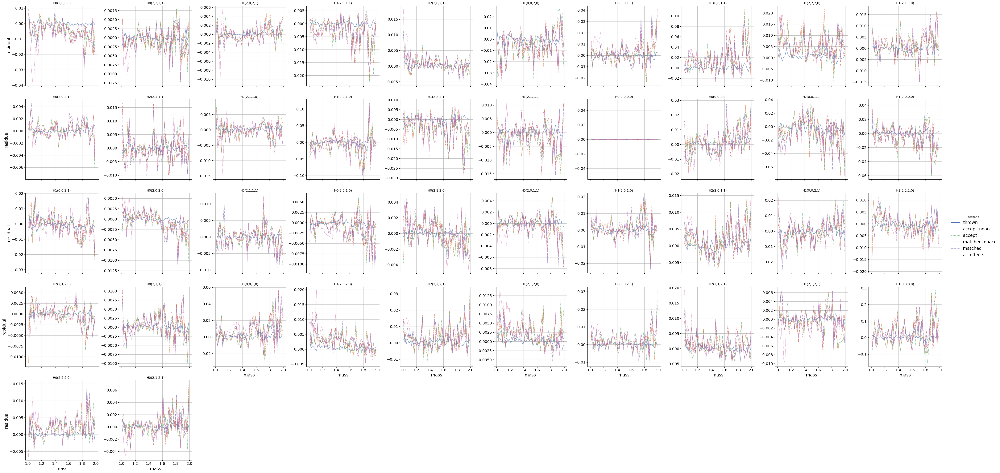

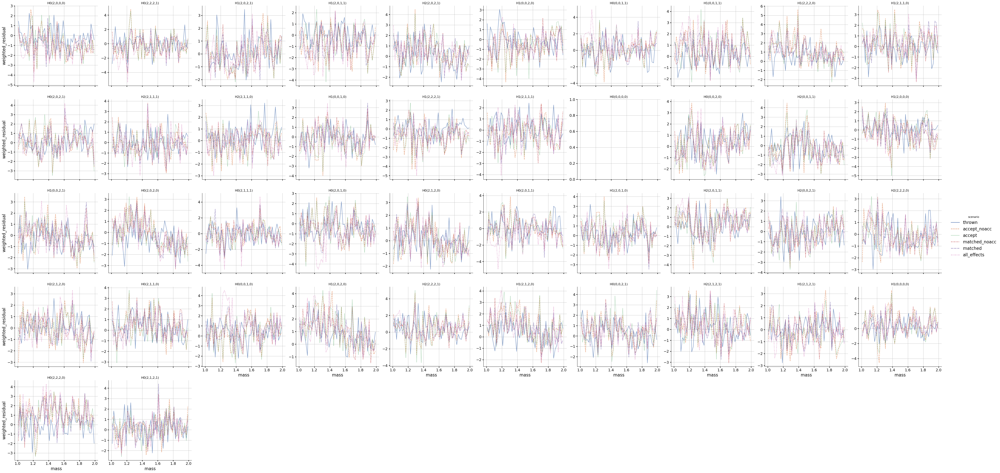

In [19]:
# plot the residuals for every moment
df_melted = residual_df.melt(id_vars=["mass", "scenario"], var_name="moment", value_name="residual")
grid = sns.relplot(
    data=df_melted, x="mass", y="residual", col="moment", 
    col_wrap=10, kind="line", hue="scenario", style="scenario", 
    palette=SCENARIO_COLORS,
    facet_kws={'sharey': False}
)

for ax in grid.axes.flat:
    # remove the "moment = " from the title
    subplot_title = ax.get_title()
    ax.set_title(subplot_title.replace("moment = ", ""))
    # set the alpha value of each marker
    for line in ax.get_lines():
        line.set_alpha(0.7)

plt.show()

# plot the weighted residuals for every moment
df_melted = weighted_residual_df.melt(id_vars=["mass", "scenario"], var_name="moment", value_name="weighted_residual")
grid = sns.relplot(
    data=df_melted, x="mass", y="weighted_residual", col="moment", 
    col_wrap=10, kind="line", hue="scenario", style="scenario", 
    palette=SCENARIO_COLORS,
    facet_kws={'sharey': False}
)

for ax in grid.axes.flat:
    # remove the "moment = " from the title
    subplot_title = ax.get_title()
    ax.set_title(subplot_title.replace("moment = ", ""))
    # set the alpha value of each marker
    for line in ax.get_lines():
        line.set_alpha(0.7)

plt.show()

Now we can plot the reduced $\chi^2$ alongside the coherent sums of the $J^P$ values

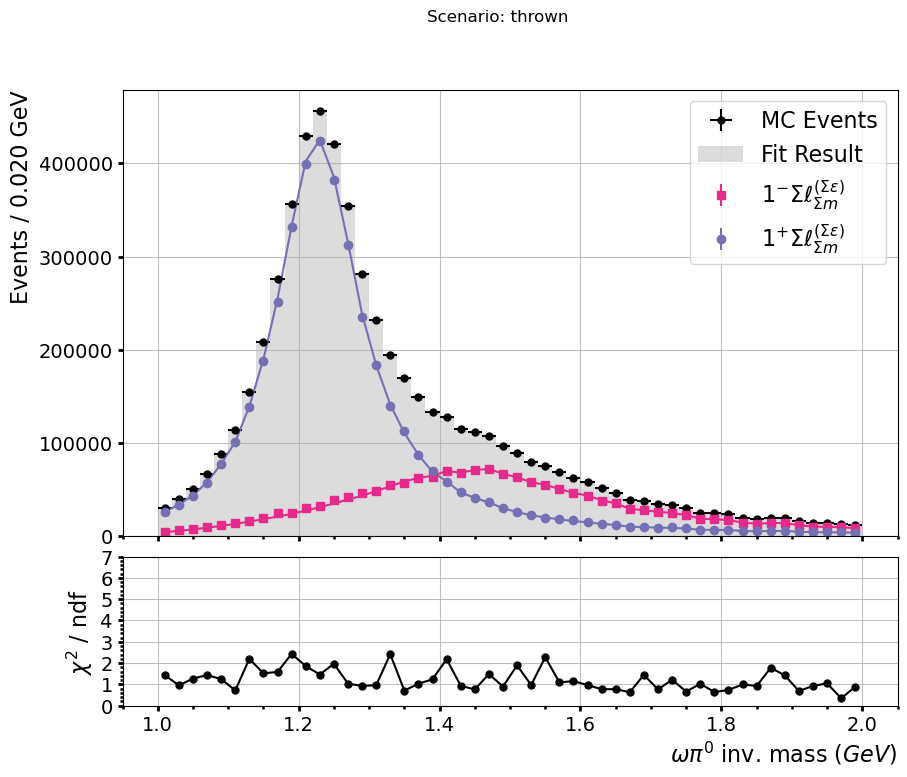

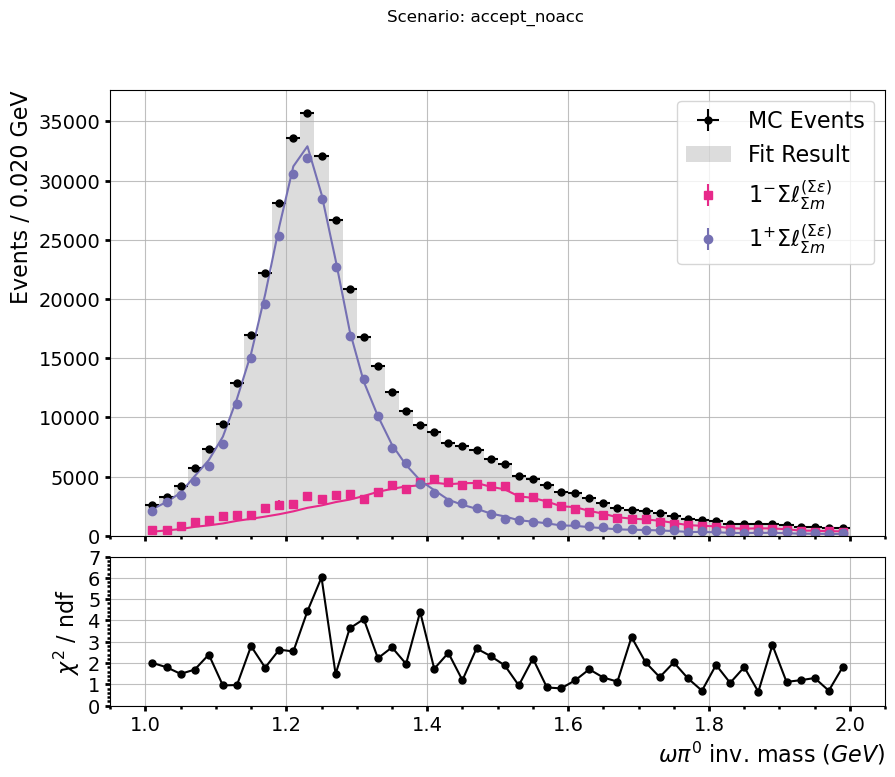

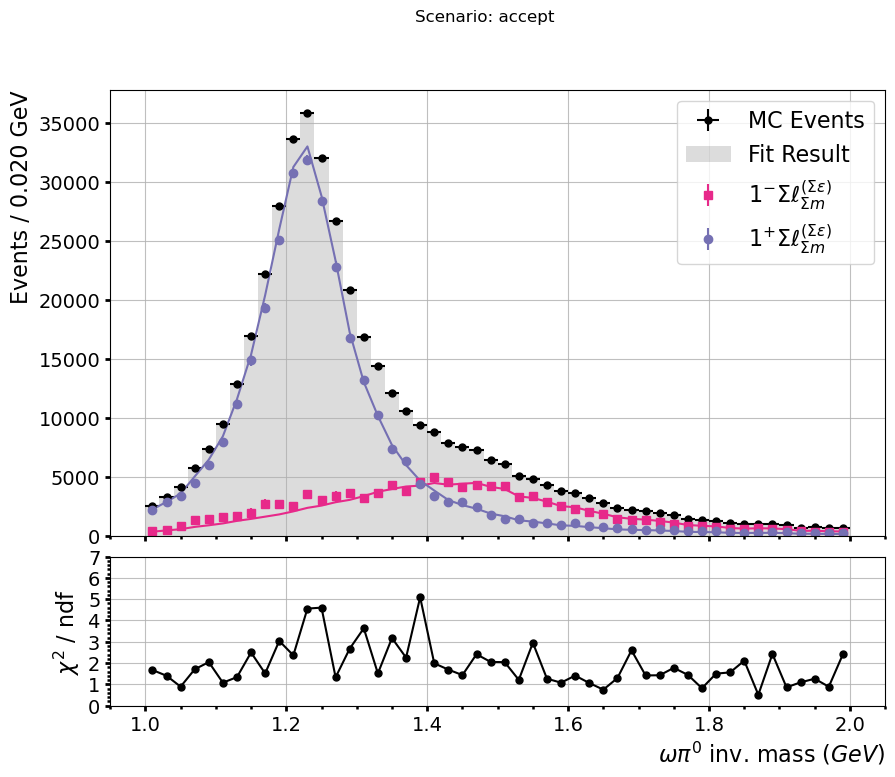

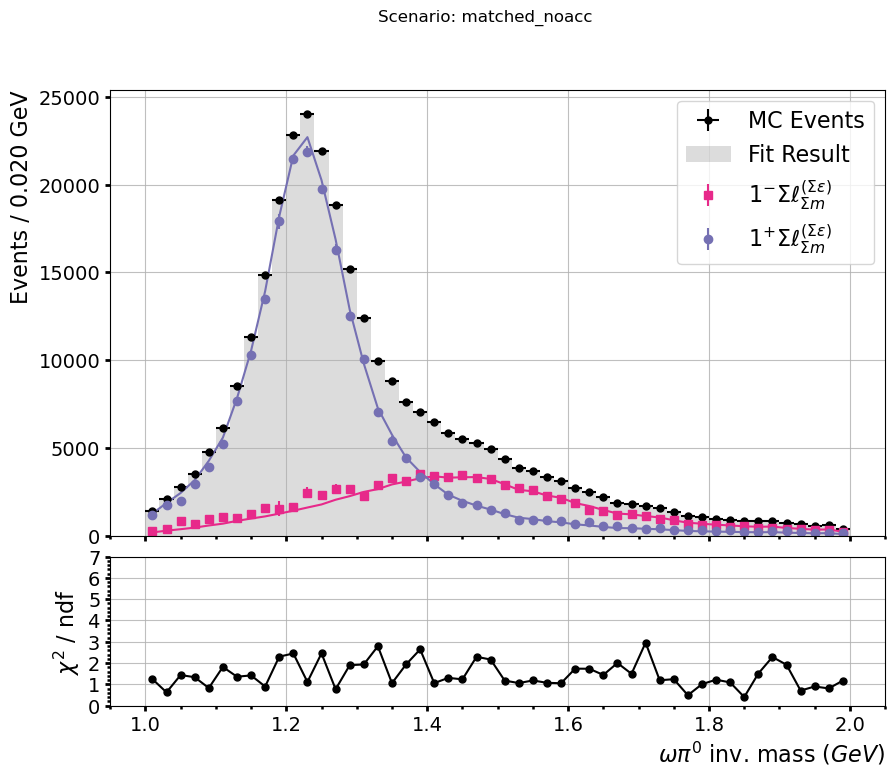

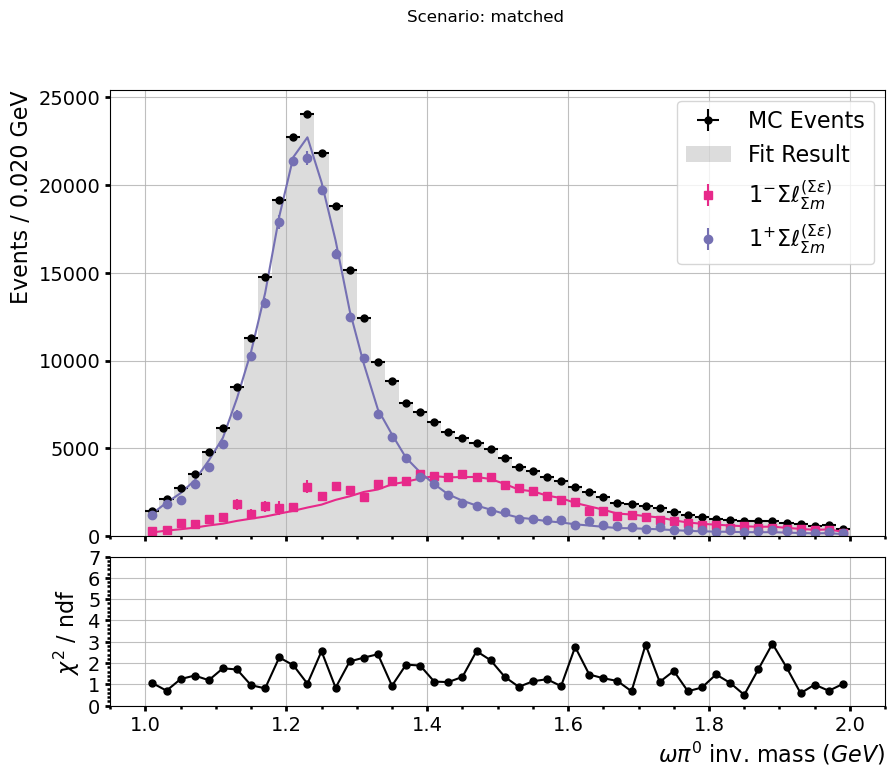

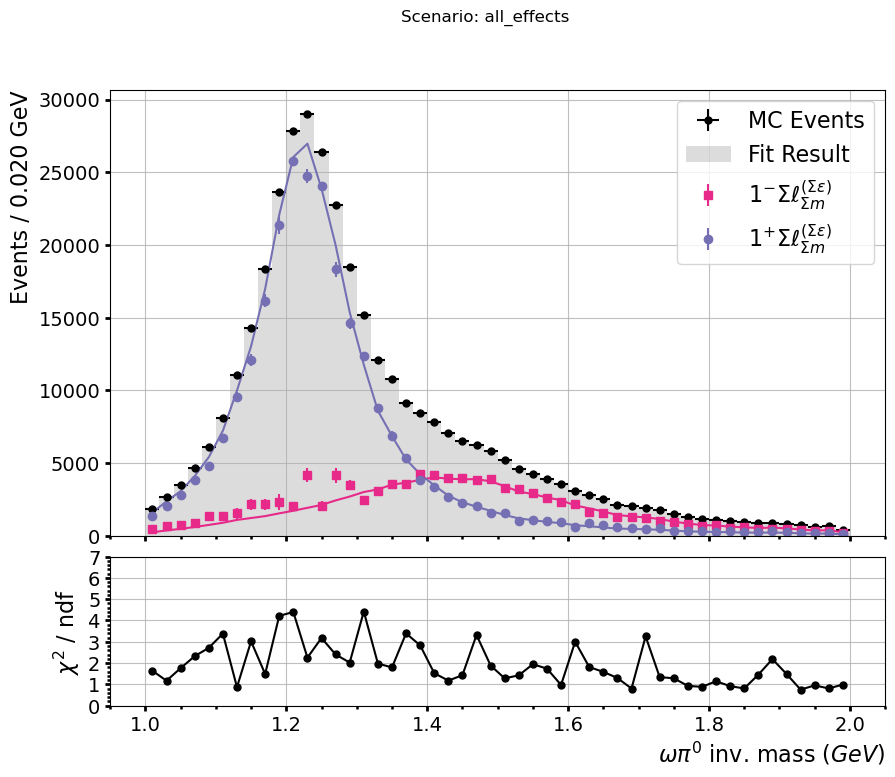

In [20]:
def plot_jp_chi2(fit_df, data_df, truth_df, chi2_df, scenario):
    # grab the mass bins and widths
    mass_bins = data_df["m_center"]
    bin_width = data_df["m_high"].iloc[0] - data_df["m_low"].iloc[0]
    
    fig, axs = plt.subplots(
        2, 1,
        sharex=True,
        gridspec_kw={"wspace": 0.0, "hspace": 0.07},
        height_ratios=[3, 1],
    )

    # ---AXS 0---
    # plot the data events
    axs[0].errorbar(
        x=mass_bins, y=data_df["events"], xerr = bin_width/2.0, yerr=data_df["events_err"],
        fmt="k.", linestyle="", label="MC Events"
    )

    # plot fit result as gray histogram
    axs[0].bar(
        mass_bins, fit_df["detected_events"], width=bin_width,
        color="0.1", 
        alpha=0.15, label="Fit Result"
    )
    axs[0].errorbar(
        x=mass_bins, y=fit_df["detected_events"], yerr=fit_df["detected_events_err"],
        fmt=",", color="0.1", alpha=0.2, markersize=0,
    )

    # plot the jp contributions
    jp_columns = pwa_tools.get_coherent_sums(fit_df)["JP"]
    colors = mpl.colormaps["Dark2"].colors
    jp_map = {
        "Bkgd": {"color": colors[0], "marker": "."},
        "0m": {"color": colors[1], "marker": "1"},
        "1p": {"color": colors[2], "marker": "o"},
        "1m": {"color": colors[3], "marker": "s"},
        "2p": {"color": colors[4], "marker": "p"},
        "2m": {"color": colors[5], "marker": "h"},
        "3p": {"color": colors[6], "marker": "x"},
        "3m": {"color": colors[7], "marker": "d"},
    }
    for col in jp_columns:
        axs[0].errorbar(
            x=mass_bins, y=fit_df[col], yerr=fit_df[f"{col}_err"],
            marker=jp_map[col]["marker"], linestyle="", color=jp_map[col]["color"], markersize=6,            
            label=pwa_tools.convert_amp_name(col)
        )
        axs[0].plot(
            mass_bins, truth_df[col],
            linestyle="-", marker="", color=jp_map[col]["color"]
        )

    axs[0].set_ylabel(f"Events / {bin_width:.3f} GeV", loc="top")
    axs[0].set_ylim(bottom=0.0)
    axs[0].legend(loc="upper right")

    # ---AXS 1---
    # plot the chi2
    axs[1].plot(
        mass_bins, chi2_df["chi2"],
        marker=".", linestyle="-", color="black"
    )
    axs[1].set_xlabel(r"$\omega\pi^0$ inv. mass $(GeV)$", loc="right")
    axs[1].set_ylabel(r"$\chi^2$ / ndf", loc="center")
    axs[1].set_ylim(0.0, 7.0)
    axs[1].yaxis.set_major_locator(mpl.ticker.MaxNLocator(integer=True))

    plt.minorticks_on()
    plt.suptitle(f"Scenario: {scenario}")
    plt.show()

for scenario, df_dict in all_dfs.items():
    chi2_subset = reduced_chi2_df[reduced_chi2_df["scenario"] == scenario]      
    plot_jp_chi2(df_dict["fit"], df_dict["data"], df_dict["truth"], chi2_subset, scenario)

TODO: could be interesting to plot the p1mpP amplitude with its corresponding moments chi2 (and maybe individal moments) below it for each scenario,
to see how well those deviations track. On the coherent sums its a bit tough to tell because we can't see the width of the moment bootstraps. Maybe tracking the average coefficient of variation for each mass bin could help

/scratch/kscheuer/ipykernel_2161965/3886900837.py:40: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(latex_labels, rotation=45, ha="right", fontsize=10)


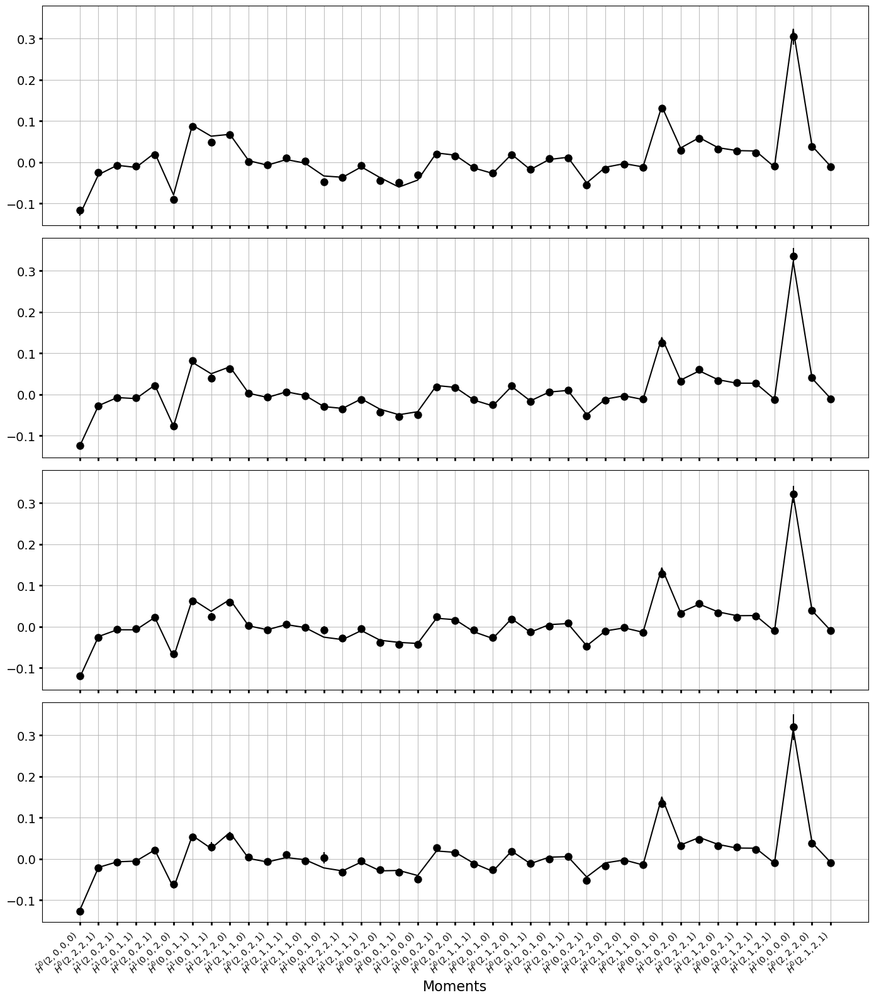

In [ ]:
df1 = all_dfs["all_effects"]["truth_moments"][all_dfs["all_effects"]["truth_moments"]["mass"] == "1.200-1.220"]
df1_fit = all_dfs["all_effects"]["fit_moments"][all_dfs["all_effects"]["fit_moments"]["mass"] == "1.200-1.220"]

df2 = all_dfs["all_effects"]["truth_moments"][all_dfs["all_effects"]["truth_moments"]["mass"] == "1.220-1.240"]
df2_fit = all_dfs["all_effects"]["fit_moments"][all_dfs["all_effects"]["fit_moments"]["mass"] == "1.220-1.240"]

df3 = all_dfs["all_effects"]["truth_moments"][all_dfs["all_effects"]["truth_moments"]["mass"] == "1.240-1.260"]
df3_fit = all_dfs["all_effects"]["fit_moments"][all_dfs["all_effects"]["fit_moments"]["mass"] == "1.240-1.260"]

df4 = all_dfs["all_effects"]["truth_moments"][all_dfs["all_effects"]["truth_moments"]["mass"] == "1.260-1.280"]
df4_fit = all_dfs["all_effects"]["fit_moments"][all_dfs["all_effects"]["fit_moments"]["mass"] == "1.260-1.280"]

moment_cols = [c for c in df1 if c.startswith("H")]
moment_cols.remove("H0(0,0,0,0)")
moment_errs = [f"{col}_err" for col in moment_cols]

fig, axs = plt.subplots(4, 1, figsize=(14, 16), sharex=True, sharey=True)

dfs = [(df1, df1_fit), (df2, df2_fit), (df3, df3_fit), (df4, df4_fit)]

for i, (df, df_fit) in enumerate(dfs):
    axs[i].plot(moment_cols, df[moment_cols].values.flatten(), marker="", linestyle="-", color="black")
    axs[i].errorbar(
        x=moment_cols, y=df_fit[moment_cols].values.flatten(), yerr=df_fit[moment_errs].values.flatten(),
        marker="o", markersize=8, linestyle="", color="black"
    )    
    axs[i].grid(True)

# convert the moment labels into nicer LaTeX versions
axs[-1].set_xlabel("Moments")
ax = axs[-1]
labels = [item.get_text() for item in ax.get_xticklabels()]
latex_labels = []
for label in labels:
    alpha = label[1]
    new_label = label.replace(f"{alpha}", f"^{{{alpha}}}", 1)
    new_label = new_label.replace("H", r"\hat{H}")    
    latex_labels.append(rf"${new_label}$")
ax.set_xticklabels(latex_labels, rotation=45, ha="right", fontsize=10)

plt.tight_layout()
plt.show()


/scratch/kscheuer/ipykernel_2161965/1226453864.py:34: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(latex_labels, rotation=45, ha="right", fontsize=10)


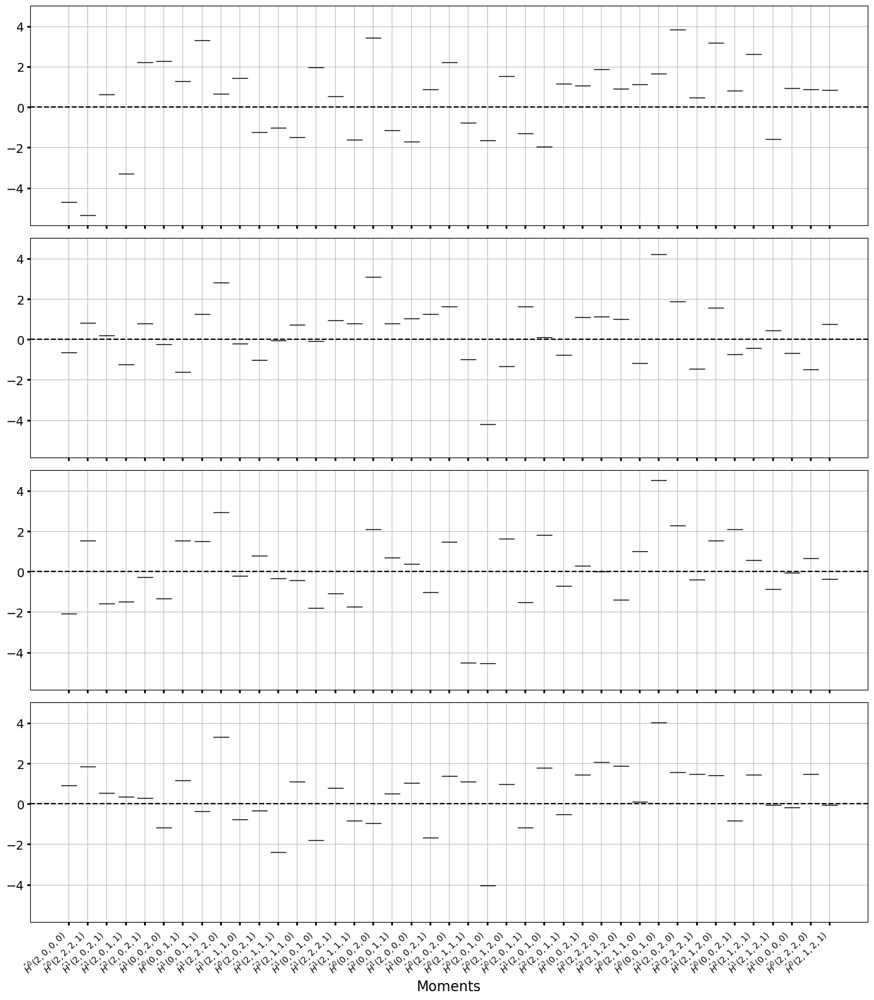

In [39]:
df1 = weighted_residual_df[(weighted_residual_df["scenario"] == "all_effects") & (weighted_residual_df["mass"] == 1.21)]

df2 = weighted_residual_df[(weighted_residual_df["scenario"] == "all_effects") & (weighted_residual_df["mass"] == 1.23)]

df3 = weighted_residual_df[(weighted_residual_df["scenario"] == "all_effects") & (weighted_residual_df["mass"] == 1.25)]

df4 = weighted_residual_df[(weighted_residual_df["scenario"] == "all_effects") & (weighted_residual_df["mass"] == 1.27)]

moment_cols = [c for c in df1 if c.startswith("H")]
moment_cols.remove("H0(0,0,0,0)")

fig, axs = plt.subplots(4, 1, figsize=(14, 16), sharex=True, sharey=True)

dfs = [(df1, df1_fit), (df2, df2_fit), (df3, df3_fit), (df4, df4_fit)]

for i, (df, df_fit) in enumerate(dfs):
    axs[i].plot(
        moment_cols, df[moment_cols].values.flatten(), 
        marker="_", linestyle="", color="black", markersize=18, markevery=1
    )
    axs[i].axhline(0, color="black", linestyle="--")
    axs[i].grid(True)

# convert the moment labels into nicer LaTeX versions
axs[-1].set_xlabel("Moments")
ax = axs[-1]
labels = [item.get_text() for item in ax.get_xticklabels()]
latex_labels = []
for label in labels:
    alpha = label[1]
    new_label = label.replace(f"{alpha}", f"^{{{alpha}}}", 1)
    new_label = new_label.replace("H", r"\hat{H}")    
    latex_labels.append(rf"${new_label}$")
ax.set_xticklabels(latex_labels, rotation=45, ha="right", fontsize=10)

plt.tight_layout()
plt.show()

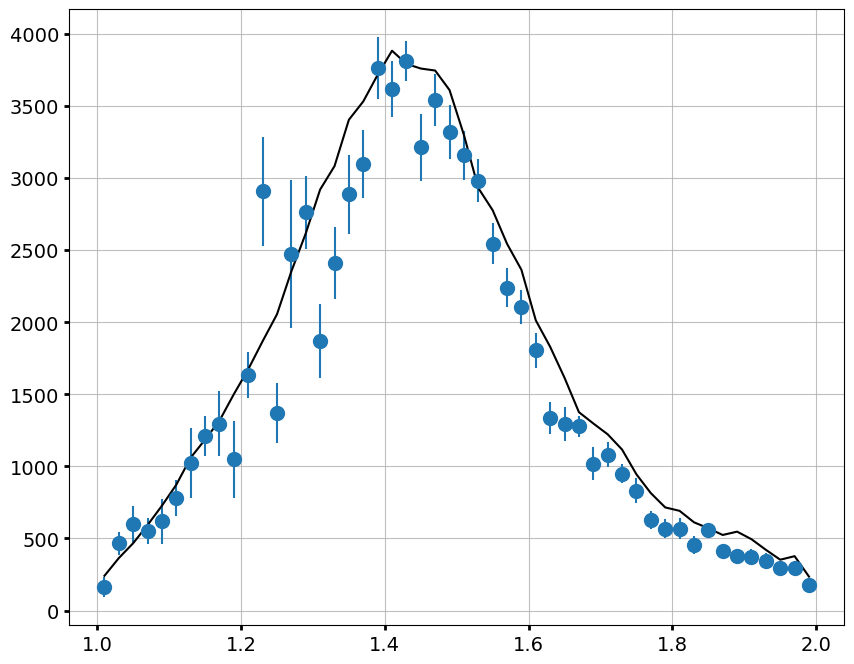

In [28]:
# plot just the p1mpP amplitude across the mass
df = all_dfs["all_effects"]["fit"]
mass_bins = all_dfs["all_effects"]["data"]["m_center"]
plt.errorbar(x=mass_bins, y=df["p1mpP"], yerr=df["p1mpP_err"], fmt="o")
plt.plot(mass_bins, all_dfs["all_effects"]["truth"]["p1mpP"], color="black")

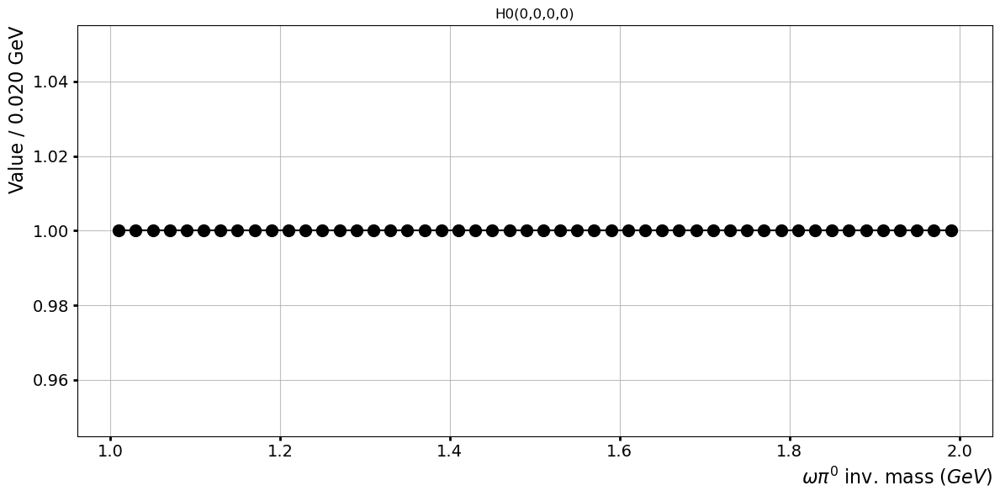

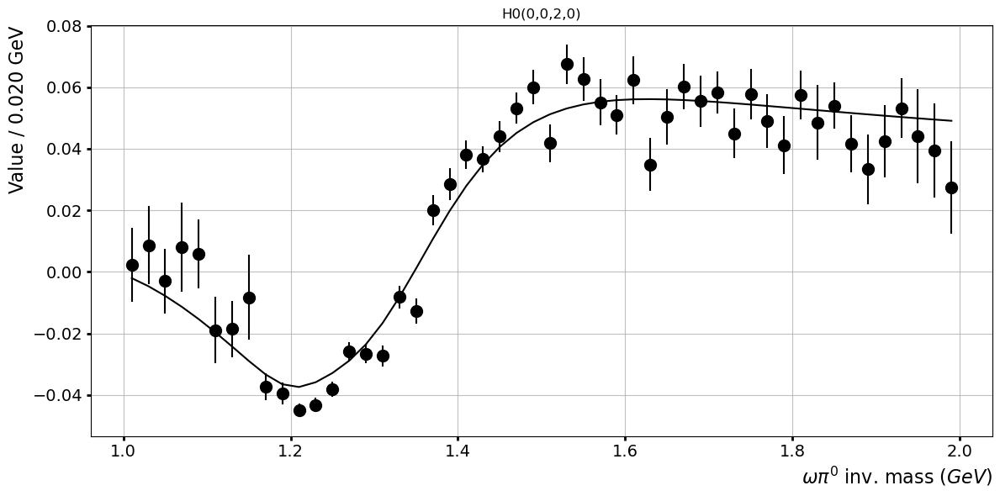

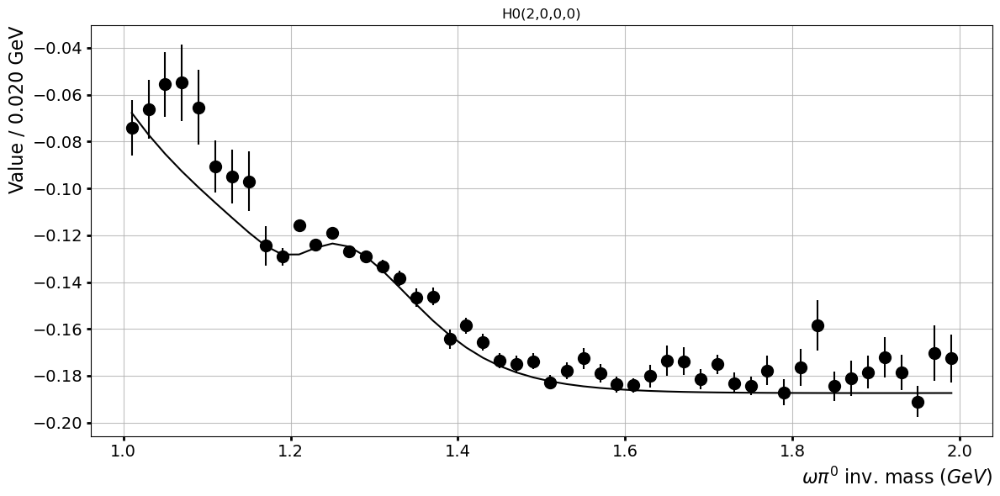

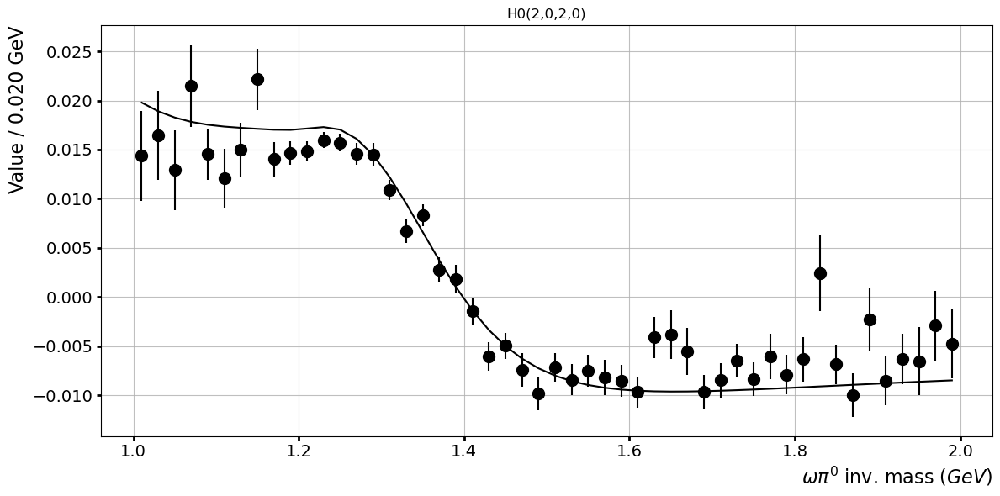

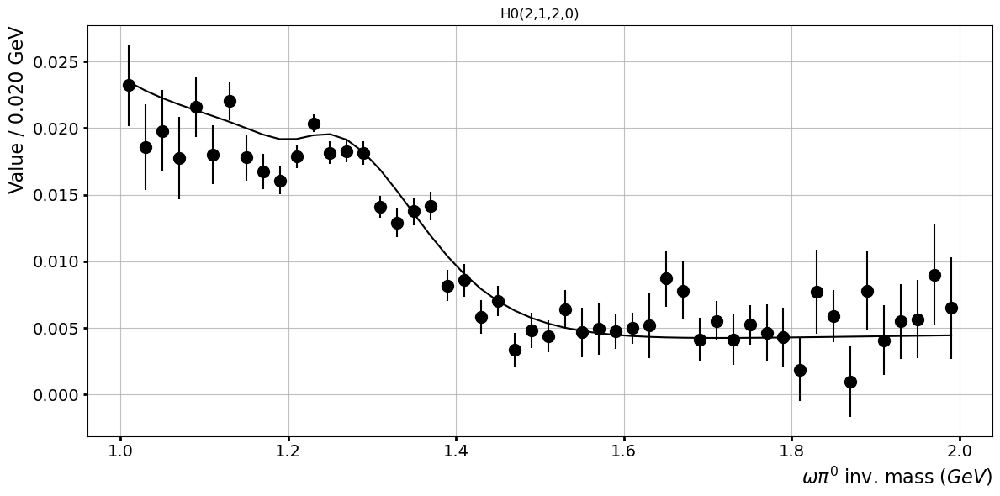

...

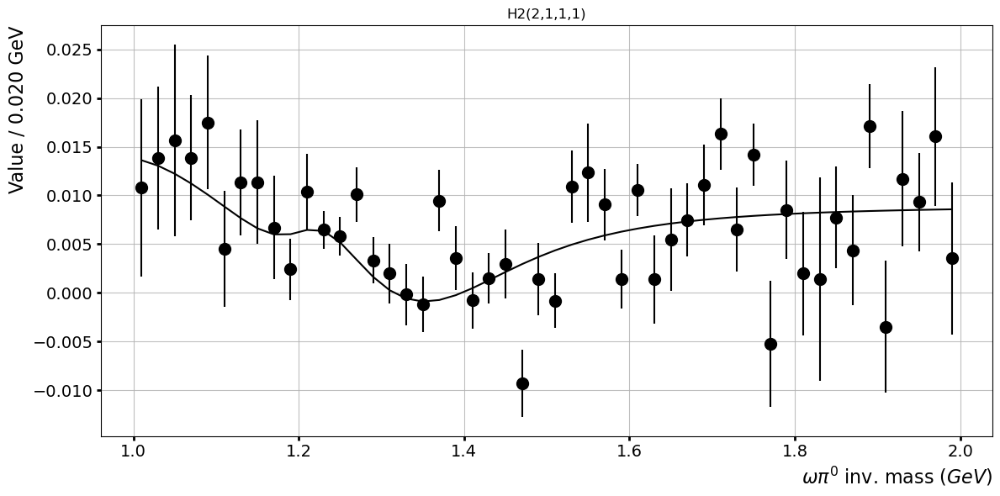

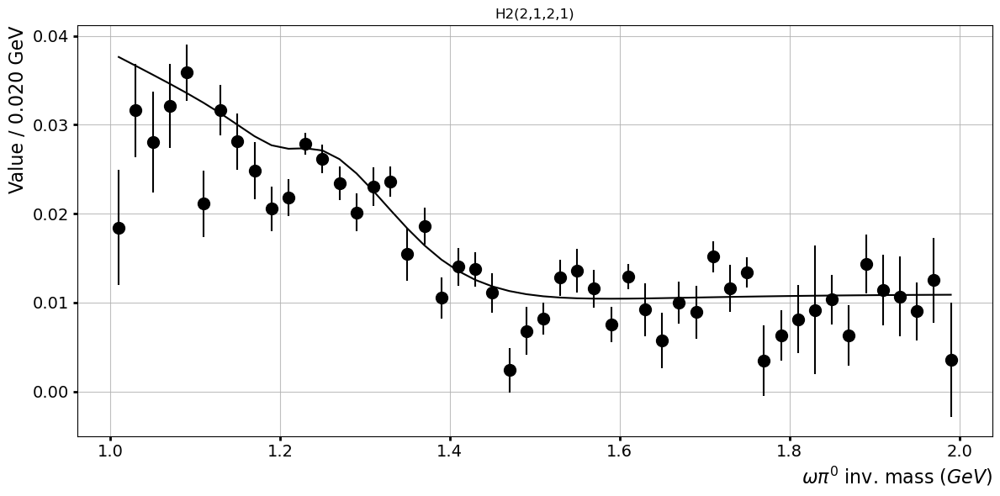

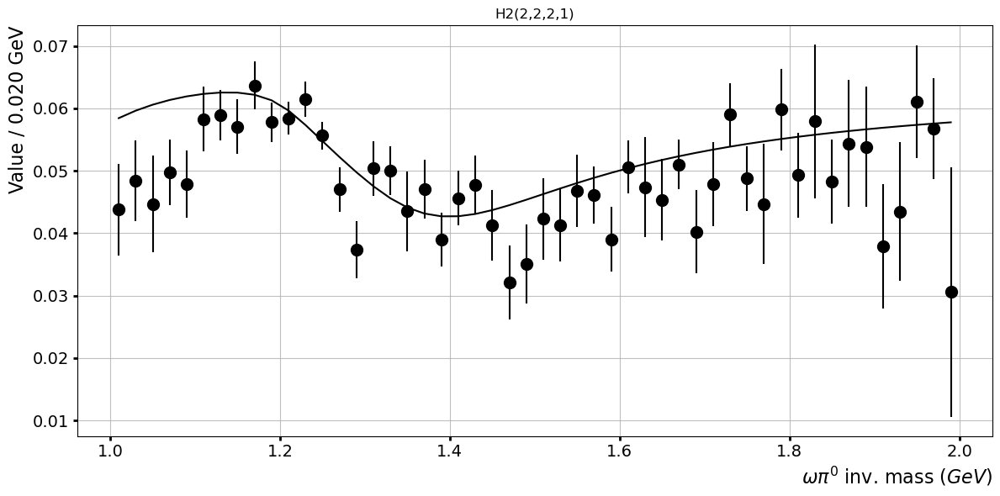

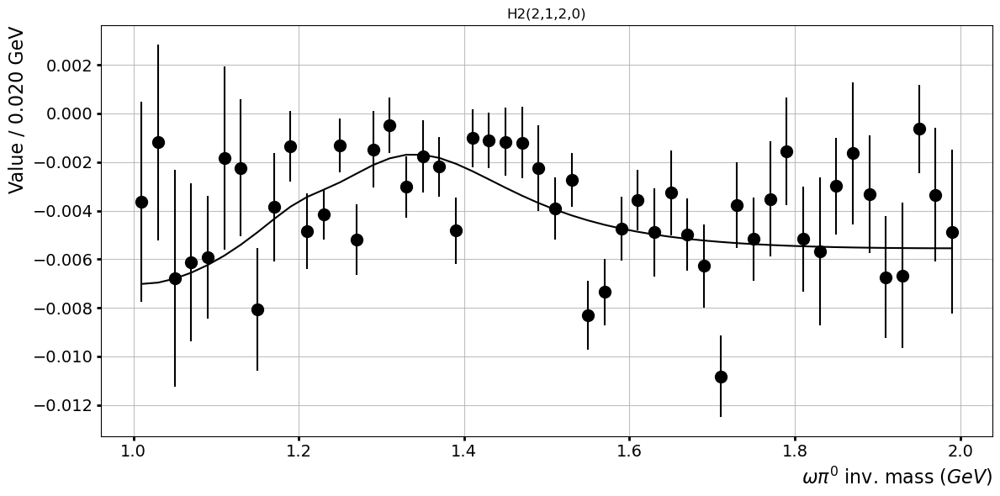

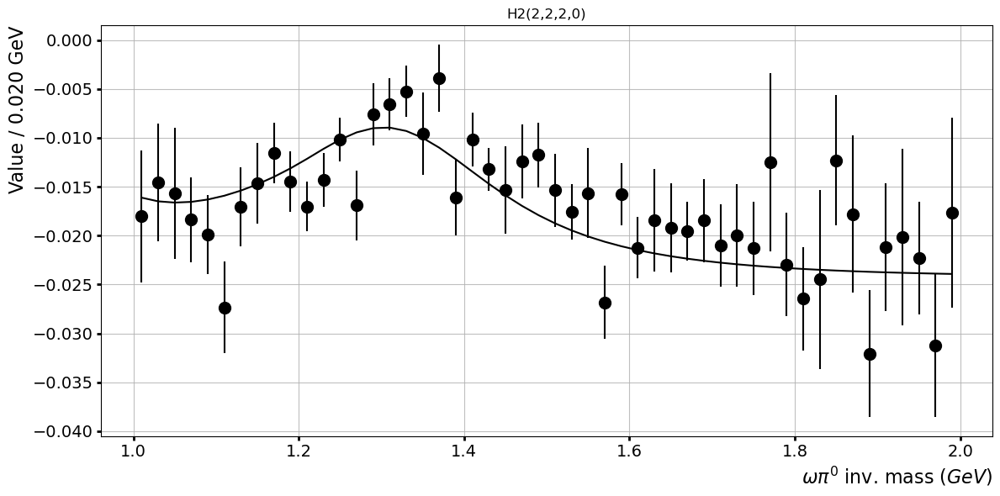

In [45]:
# lets find all the moments that contribute to the p1mpP amplitude using the table
table = all_dfs["all_effects"]["table"]
p1mpP_moments = table[(table["wave1"] == "p1mpP") | (table["wave2"] == "p1mpP")]
moment_cols = [c for c in p1mpP_moments.columns if c.startswith("H")]

# Drop columns where all values are near zero
near_zero_threshold = 1e-10
filtered_moment_cols = p1mpP_moments[moment_cols].loc[:, (p1mpP_moments[moment_cols].abs() > near_zero_threshold).any()]

# Plot the fit values and errors of the filtered moments, each on separate plots
fit_moments = all_dfs["all_effects"]["fit_moments"]
truth_moments = all_dfs["all_effects"]["truth_moments"]
mass_bins = all_dfs["all_effects"]["data"]["m_center"]
bin_width = (all_dfs["all_effects"]["data"]["m_high"] - all_dfs["all_effects"]["data"]["m_low"]).iloc[0]

for moment in filtered_moment_cols.columns:
    if moment not in fit_moments.columns:
        continue # skip those moments whose total value is near zero
    truth_values = truth_moments[moment]
    fit_values = fit_moments[moment]
    fit_errors = fit_moments[f"{moment}_err"]
    
    fig, ax = plt.subplots(figsize=(12, 6))
    ax.errorbar(
        x=mass_bins, y=fit_values, yerr=fit_errors,
        marker='o', linestyle="", color="black"
    )
    ax.plot(mass_bins, truth_values, marker="", linestyle="-", color="black")

    ax.set_xlabel(r"$\omega\pi^0$ inv. mass $(GeV)$", loc="right")
    ax.set_ylabel(f"Value / {bin_width:.3f} GeV", loc="top")    
    ax.grid(True)
    ax.set_title(f"{moment}")
    plt.tight_layout()
    plt.show()
